In [1]:
from __future__ import division
from matplotlib import pyplot as plt
import matplotlib
matplotlib.rcParams['figure.dpi'] = 500
import seaborn as sns
import os
import numpy as np

In [369]:
sns.axes_style("white")

{'figure.facecolor': 'white',
 'axes.labelcolor': '.15',
 'xtick.direction': 'out',
 'ytick.direction': 'out',
 'xtick.color': '.15',
 'ytick.color': '.15',
 'axes.axisbelow': True,
 'grid.linestyle': '-',
 'text.color': '.15',
 'font.family': ['sans-serif'],
 'font.sans-serif': ['Arial',
  'DejaVu Sans',
  'Liberation Sans',
  'Bitstream Vera Sans',
  'sans-serif'],
 'lines.solid_capstyle': 'round',
 'patch.edgecolor': 'w',
 'patch.force_edgecolor': True,
 'image.cmap': 'rocket',
 'xtick.top': False,
 'ytick.right': False,
 'axes.grid': False,
 'axes.facecolor': 'white',
 'axes.edgecolor': '.15',
 'grid.color': '.8',
 'axes.spines.left': True,
 'axes.spines.bottom': True,
 'axes.spines.right': True,
 'axes.spines.top': True,
 'xtick.bottom': False,
 'ytick.left': False}

In [370]:
birth = 1
mut = 0.01
death = 0.25
f1ratio = np.array([0.05 * i for i in range(20,101)])
f1netbirth0 = birth - mut - death - (birth - mut - death) * (1 + f1ratio) / 2
f1netbirth1 = birth - mut - death - (birth - mut - death) * (1 + f1ratio) / (2 * f1ratio)
f2ratio = 2
f2pop = np.array([0.01 * i for i in range(101)])
f2netbirth0 = birth - mut - death - (birth - mut - death) * (1 + f2ratio) * f2pop
f2netbirth1 = birth - mut - death - (birth - mut - death) * (1 + f2ratio) / f2ratio * f2pop

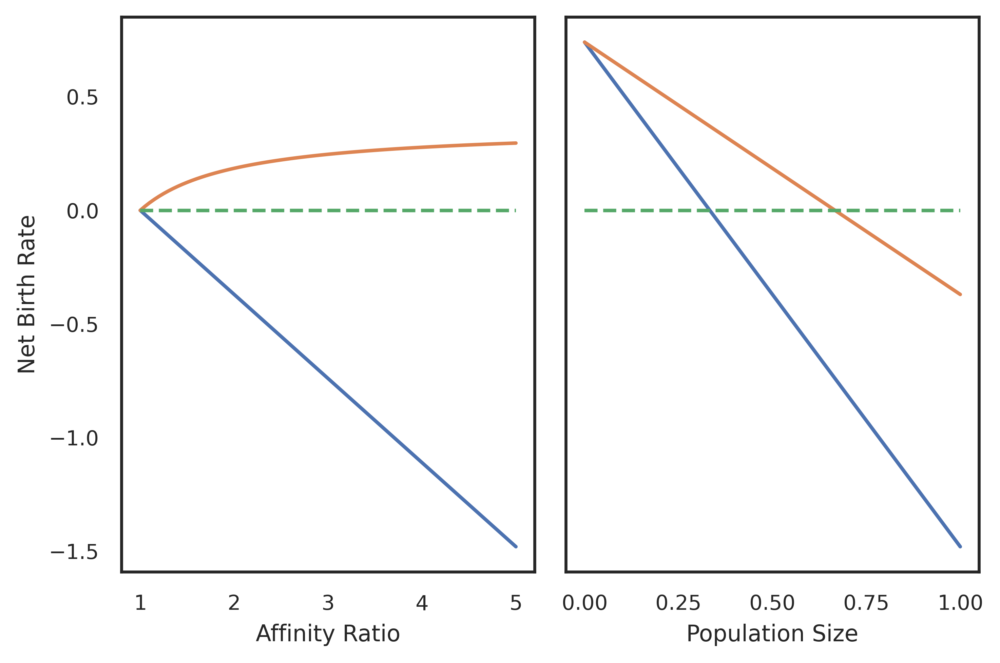

In [371]:
sns.set(font_scale=0.8)
with sns.axes_style("white"):
    fig, axes = plt.subplots(1, 2, sharey=True)
    axes[0].plot(f1ratio, f1netbirth0)
    axes[0].plot(f1ratio, f1netbirth1)
    axes[0].plot(f1ratio, [0] * len(f1ratio), "--")
    axes[1].plot(f2pop, f2netbirth0)
    axes[1].plot(f2pop, f2netbirth1)
    axes[1].plot(f2pop, [0] * len(f2pop), "--")
    axes[0].set_ylabel("Net Birth Rate")
    axes[0].set_xlabel("Affinity Ratio")
    axes[1].set_xlabel("Population Size")
    plt.tight_layout()
    sns.set(font_scale=1)
    plt.savefig("net_birth.pdf")

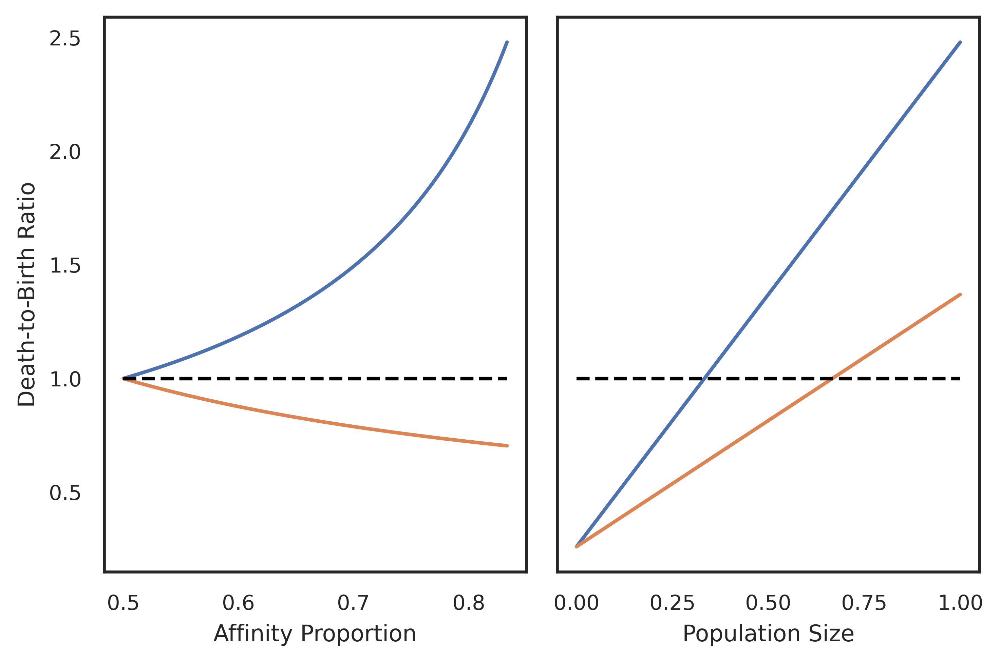

In [462]:
birth = 1
mut = 0.01
death = 0.25
f1ratio = np.array([0.05 * i for i in range(20,101)])
r1birth0 = mut + death + (birth - mut - death) * (1 + f1ratio) / 2
r1birth1 = mut + death + (birth - mut - death) * (1 + f1ratio) / (2 * f1ratio)
f1prop = f1ratio / (1 + f1ratio)
f2ratio = 2
f2pop = np.array([0.01 * i for i in range(101)])
r2birth0 = mut + death + (birth - mut - death) * (1 + f2ratio) * f2pop
r2birth1 = mut + death + (birth - mut - death) * (1 + f2ratio) / f2ratio * f2pop
sns.set(font_scale=0.8)
with sns.axes_style("white"):
    fig, axes = plt.subplots(1, 2, sharey=True)
    axes[0].plot(f1prop, r1birth0)
    axes[0].plot(f1prop, r1birth1)
    axes[0].plot(f1prop, [1] * len(f1ratio), "--", c="black")
    axes[1].plot(f2pop, r2birth0)
    axes[1].plot(f2pop, r2birth1)
    axes[1].plot(f2pop, [1] * len(f2pop), "--", c="black")
    axes[0].set_ylabel("Death-to-Birth Ratio")
    axes[0].set_xlabel("Affinity Proportion")
    axes[1].set_xlabel("Population Size")
    plt.tight_layout()
    sns.set(font_scale=1)
    plt.savefig("death_birth.pdf")

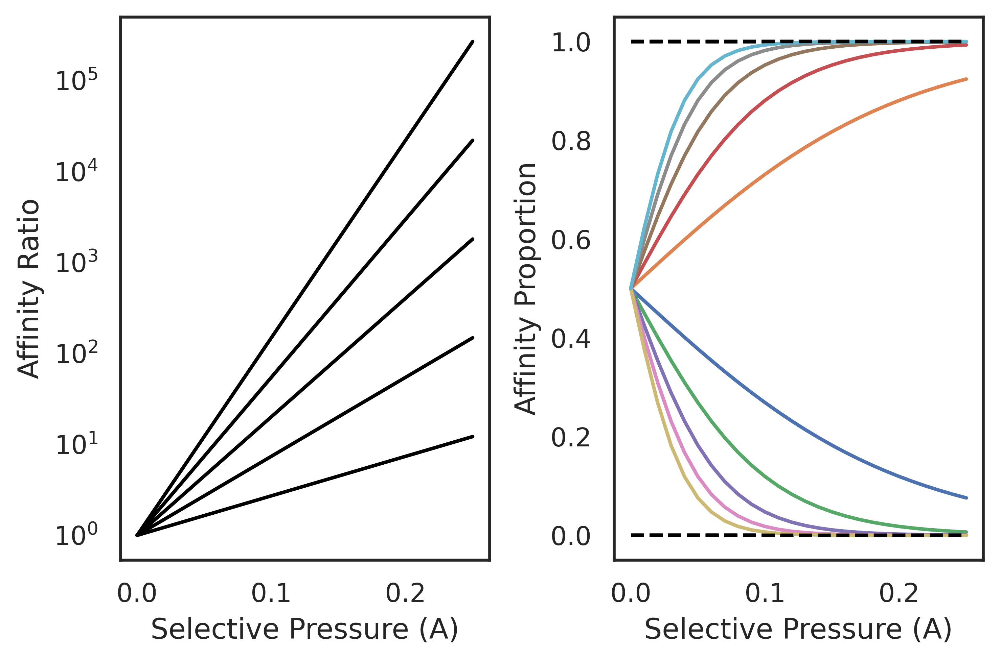

In [373]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(1, 2) #, sharey=True)
    for B1 in [-40, -30, -20, -10, 0]:
        A = np.array([0.01 * i for i in range(0,26)])
        B0 = -50
        Aff0 = np.exp(A * B0)
        Aff1 = np.exp(A * B1)
        AffRatio = Aff1 / Aff0
        AffProp0 = Aff0 / (Aff0 + Aff1)
        AffProp1 = Aff1 / (Aff0 + Aff1)

        sns.set(font_scale=0.8)

        axes[0].plot(A, AffRatio,  c="black")
        axes[1].plot(A, AffProp0)
        axes[1].plot(A, AffProp1)
        axes[1].plot(A, [1] * len(A), "--", c="black")
        axes[1].plot(A, [0] * len(A), "--", c="black")
    #axes[1].plot(f2pop, [1] * len(f2pop), "--", c="black")
    axes[0].set_ylabel("Selective Pressure (A)")
    axes[0].set_xlabel("Affinity Ratio")
    axes[1].set_xlabel("Affinity Proportion")
    axes[0].set_ylabel("Affinity Ratio")
    axes[0].set_yscale('log')
    axes[1].set_ylabel("Affinity Proportion")
    axes[0].set_xlabel("Selective Pressure (A)")
    axes[1].set_xlabel("Selective Pressure (A)")
    plt.tight_layout()
    sns.set(font_scale=1)
    plt.savefig("aff_A.pdf")
    # remove left panel & fix color & combine with previous figure

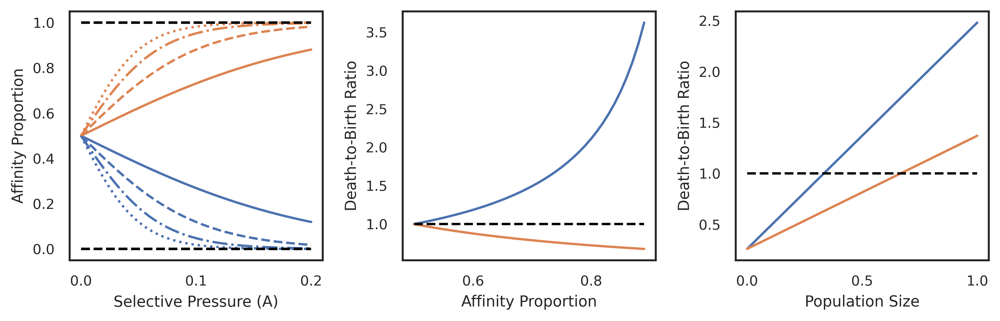

In [479]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(1, 3) #, sharey=True)
    style = {-110:'-', -100:'--', -90:'-.', -80:':'}
    for B1 in [-110, -100, -90, -80]:
        A = np.array([0.005 * i for i in range(0,41)])
        B0 = -120
        Aff0 = np.exp(A * B0)
        Aff1 = np.exp(A * B1)
        AffRatio = Aff1 / Aff0
        AffProp0 = Aff0 / (Aff0 + Aff1)
        AffProp1 = Aff1 / (Aff0 + Aff1)

        sns.set(font_scale=0.8)

        #axes[0].plot(A, AffRatio, style[B1], c=plt.rcParams['axes.prop_cycle'].by_key()['color'][1])
        axes[0].plot(A, AffProp0, style[B1], c=plt.rcParams['axes.prop_cycle'].by_key()['color'][0])
        axes[0].plot(A, AffProp1, style[B1], c=plt.rcParams['axes.prop_cycle'].by_key()['color'][1])
        axes[0].plot(A, [1] * len(A), "--", c="black")
        axes[0].plot(A, [0] * len(A), "--", c="black")
    #axes[1].plot(f2pop, [1] * len(f2pop), "--", c="black")
        axes[0].set_xlabel("Selective Pressure (A)")
        axes[0].set_ylabel("Affinity Proportion")
    #axes[0].set_yscale('log')
    birth = 1
    mut = 0.01
    death = 0.25
    f1prop = np.array([0.01 * i for i in range(50,90)])
    f1ratio = f1prop / (1 - f1prop)
    r1birth0 = mut + death + (birth - mut - death) * (1 + f1ratio) / 2
    r1birth1 = mut + death + (birth - mut - death) * (1 + f1ratio) / (2 * f1ratio)
    f2ratio = 2
    f2pop = np.array([0.01 * i for i in range(101)])
    r2birth0 = mut + death + (birth - mut - death) * (1 + f2ratio) * f2pop
    r2birth1 = mut + death + (birth - mut - death) * (1 + f2ratio) / f2ratio * f2pop
    axes[1].plot(f1prop, r1birth0)
    axes[1].plot(f1prop, r1birth1)
    axes[1].plot(f1prop, [1] * len(f1ratio), "--", c="black")
    axes[2].plot(f2pop, r2birth0)
    axes[2].plot(f2pop, r2birth1)
    axes[2].plot(f2pop, [1] * len(f2pop), "--", c="black")
    axes[1].set_ylabel("Death-to-Birth Ratio")
    axes[2].set_ylabel("Death-to-Birth Ratio")
    axes[1].set_xlabel("Affinity Proportion")
    axes[2].set_xlabel("Population Size")
    plt.tight_layout()
    sns.set(font_scale=1)
    fig.set_size_inches(9, 3)
    plt.tight_layout()
    plt.savefig("aff_A.pdf")
    # remove left panel & fix color & combine with previous figure

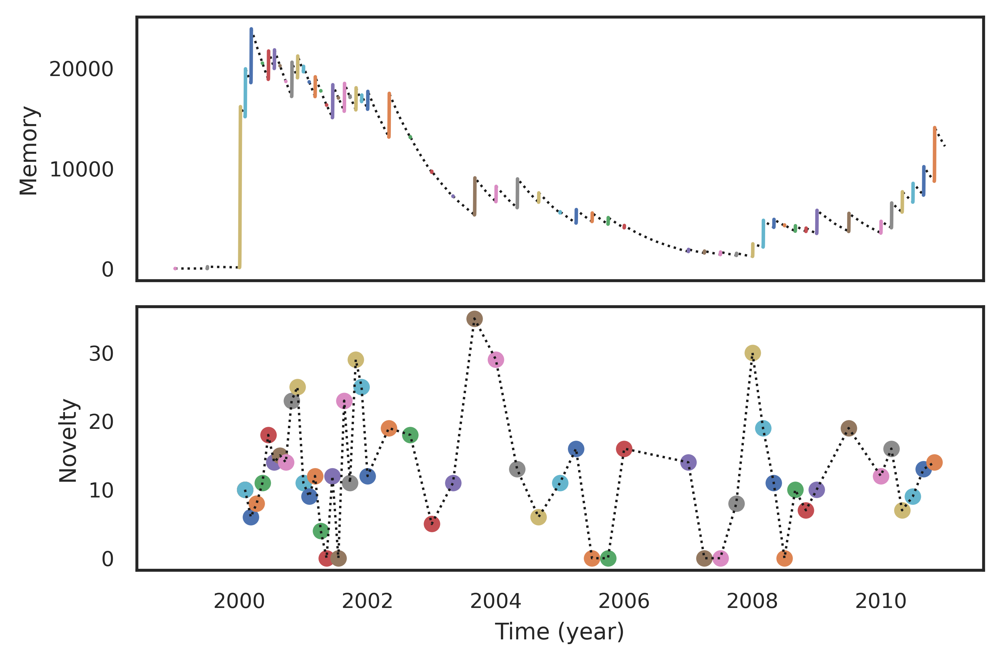

In [69]:
noveltyAll = [11235, 34, 77, 10, 6, 8, 11, 18, 14, 15, 14, 23, 25, 11, 9, 12, 4, 0, 12, 0, 23, 11, 29, 25, 12, 19, 18, 5, 11, 35, 29, 13, 6, 11, 16, 0, 0, 16, 14, 0, 0, 8, 30, 19, 11, 0, 10, 7, 10, 19, 12, 16, 7, 9, 13, 14]
time = []
tgt = []
mem = []
with open("log.txt", "r") as ins:
    for line in ins:
        arr = line.split()
        time.append(float(arr[0]))
        tgt.append(int(arr[1]))
        mem.append(int(arr[2]))
time = np.array(time) / 365 + 1999
tgt = np.array(tgt)
mem = np.array(mem)
sns.set(font_scale=0.8)
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 1, sharex=True)
    axes[0].plot(time, mem, ":k", lw=1)
    for i in range(6):
        axes[0].plot(time[0:1], mem[0:1])
    for i in range(1, 57):
        site = np.array([tgt[k] == i or (k != len(tgt) - 1 and tgt[k + 1] == i) for k in range(len(tgt))])
        axes[0].plot(time[site], mem[site])
    
    for i in range(9):
        axes[1].scatter(time[tgt == 4][0:1], [noveltyAll[3]])
    for i in range(4, 57):
        axes[1].scatter(time[tgt == i][0:1], [noveltyAll[i - 1]])
    axes[1].plot([time[tgt == i][0:1] for i in range(4, 57)], noveltyAll[3:], ":k", lw=1)
    
    axes[0].set_ylabel("Memory")
    axes[1].set_ylabel("Novelty")
    axes[1].set_xlabel("Time (year)")
    plt.tight_layout()
    sns.set(font_scale=1)
    fig.set_size_inches(6, 4)
    plt.savefig("memory.pdf")

In [65]:
tgt = []
mem = []
germ = []
aff = []
with open("default_log.txt", "r") as ins:
    for line in ins:
        arr = line.split()
        tgt.append(int(arr[0]))
        mem.append(int(arr[1]))
        germ.append(int(arr[2]))
        aff.append(float(arr[3]))
tgt = np.array(tgt)
mem = np.array(mem)
germ = np.array(germ)
aff = np.array(aff)

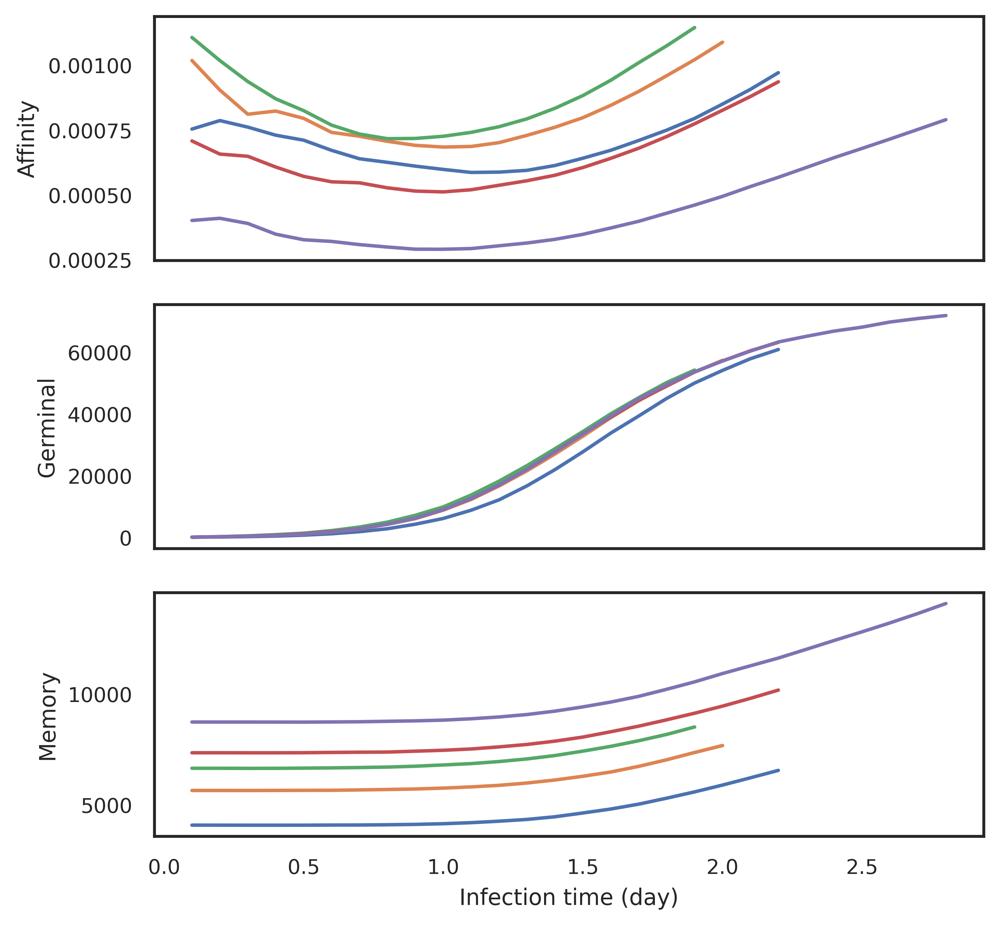

In [376]:
sns.set(font_scale=0.8)
with sns.axes_style("white"):
    fig, axes = plt.subplots(3, 1, sharex=True)
    for i in range(52, 57):
        t = aff[tgt == i]
        axes[0].plot(np.array(range(len(t))) * 0.1 + 0.1, t)
        t = germ[tgt == i]
        axes[1].plot(np.array(range(len(t))) * 0.1 + 0.1, t)
        t = mem[tgt == i]
        axes[2].plot(np.array(range(len(t))) * 0.1 + 0.1, t)


    axes[0].set_ylabel("Affinity")
    axes[1].set_ylabel("Germinal")
    axes[2].set_ylabel("Memory")
    axes[2].set_xlabel("Infection time (day)")
    plt.tight_layout()
    sns.set(font_scale=1)
    fig.set_size_inches(6, 6)
    plt.savefig("affinity.pdf")

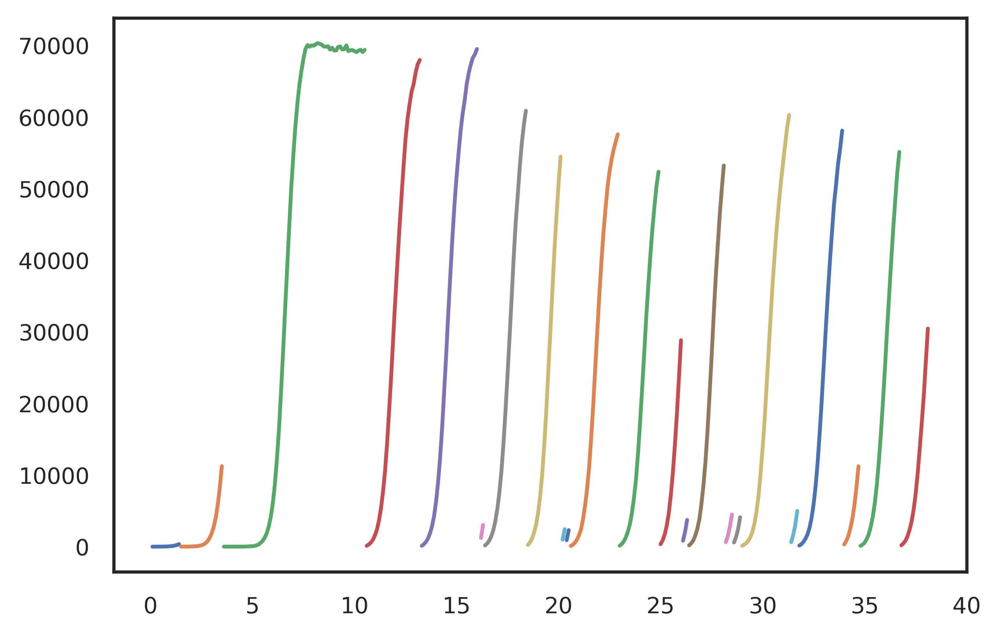

In [377]:
sns.set(font_scale=0.8)
with sns.axes_style("white"):
    s = 0.1
    for i in range(1, 25):
        t = germ[tgt == i]
        plt.plot(np.array(range(len(t))) * 0.1 + s, t)
        s += len(t) * 0.1
    sns.set(font_scale=1)
    plt.savefig("simulation.png")

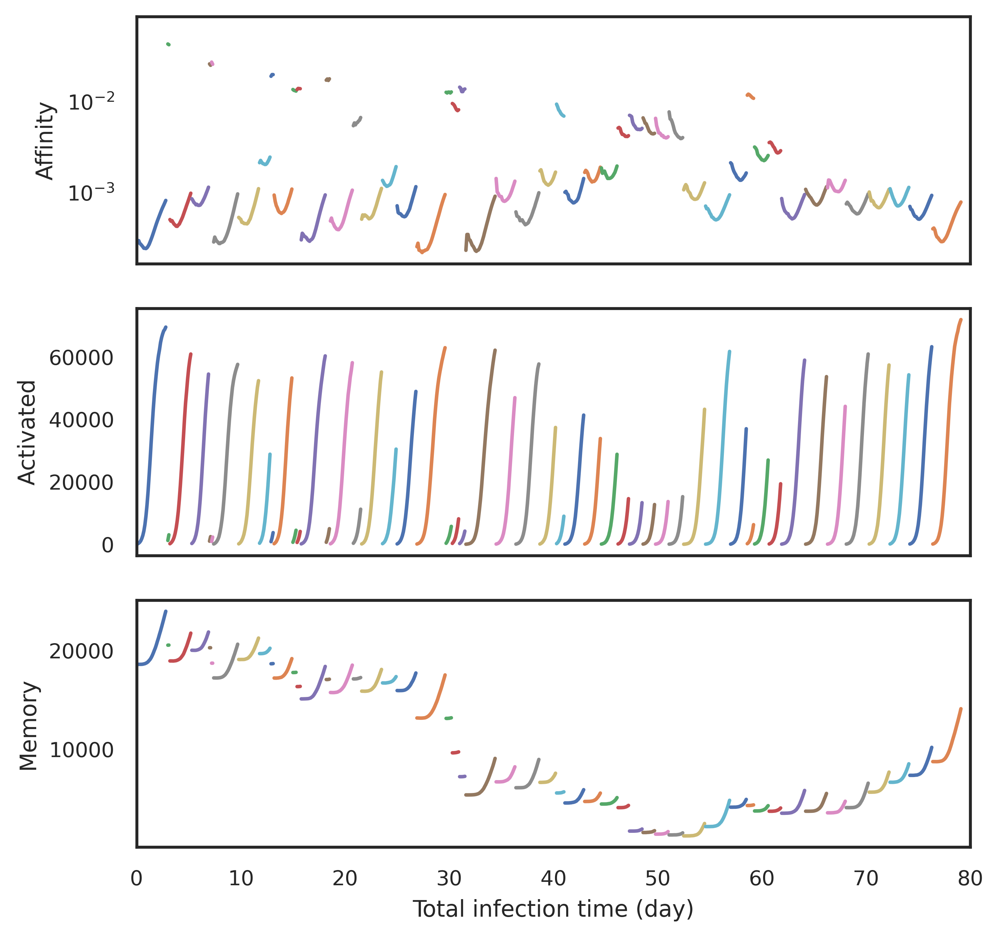

In [68]:
sns.set(font_scale=0.8)
with sns.axes_style("white"):
    fig, axes = plt.subplots(3, 1, sharex=True)
    axes[0].set_yscale('log')
    s = 0.1
    for i in range(5, 57):
        t = aff[tgt == i]
        axes[0].plot(np.array(range(len(t))) * 0.1 + s, t)
        t = germ[tgt == i]
        axes[1].plot(np.array(range(len(t))) * 0.1 + s, t)
        t = mem[tgt == i]
        axes[2].plot(np.array(range(len(t))) * 0.1 + s, t)
        s += len(t) * 0.1
    axes[0].set_ylabel("Affinity")
    axes[1].set_ylabel("Activated")
    axes[2].set_ylabel("Memory")
    axes[2].set_xlabel("Total infection time (day)")
    axes[2].set_xlim(0, 80)
    plt.tight_layout()
    sns.set(font_scale=1)
    fig.set_size_inches(6, 6)
    plt.savefig("affinity_supplement.pdf")

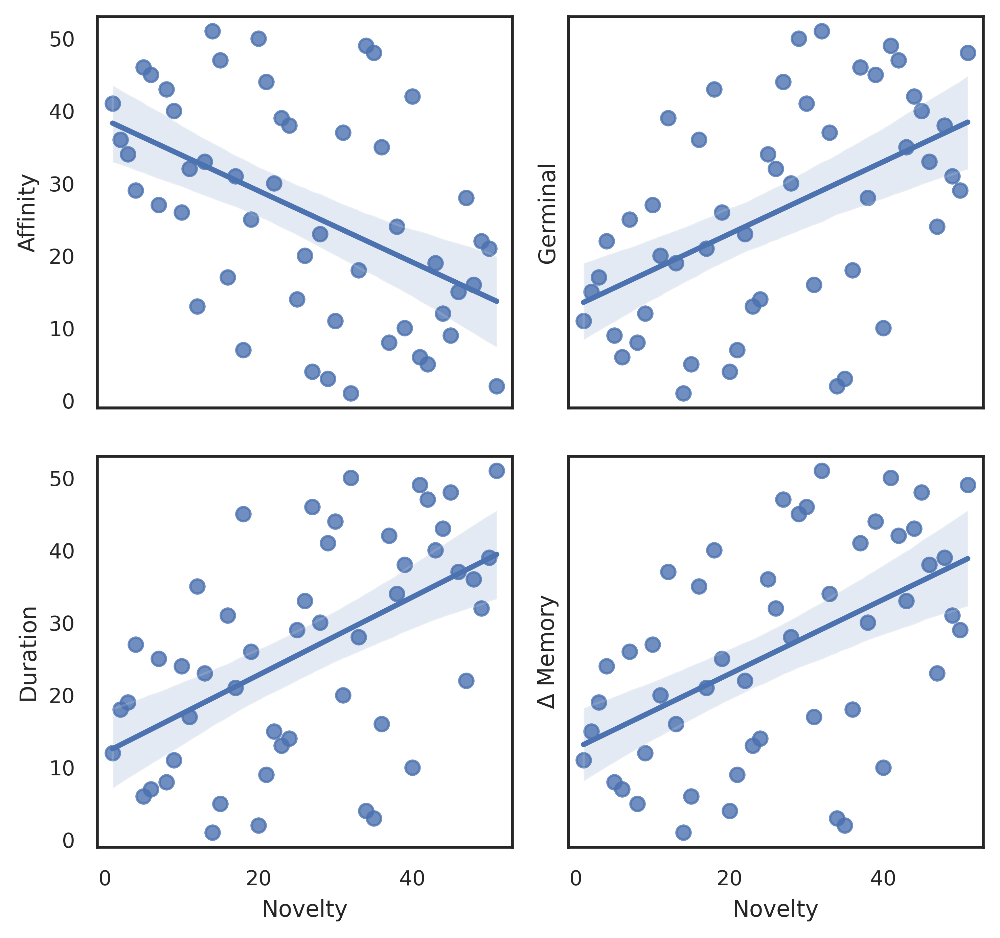

In [66]:
noveltyAll = [11235, 34, 77, 10, 6, 8, 11, 18, 14, 15, 14, 23, 25, 11, 9, 12, 4, 0, 12, 0, 23, 11, 29, 25, 12, 19, 18, 5, 11, 35, 29, 13, 6, 11, 16, 0, 0, 16, 14, 0, 0, 8, 30, 19, 11, 0, 10, 7, 10, 19, 12, 16, 7, 9, 13, 14]
sns.set(font_scale=0.8)
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharey=True, sharex=True)
x = np.argsort(noveltyAll[5:]).argsort() + 1
y0 = np.argsort([aff[tgt == i][-1] for i in range(6, 57)]).argsort() + 1
y1 = np.argsort([germ[tgt == i][-1] for i in range(6, 57)]).argsort() + 1
y2 = np.argsort([len(aff[tgt == i]) * 0.1 for i in range(6, 57)]).argsort() + 1
y3 = np.argsort([mem[tgt == i][-1] - mem[tgt == i][0] for i in range(6, 57)]).argsort() + 1
sns.regplot(x, y0, ax = axes[0,0], fit_reg=True)
sns.regplot(x, y1, ax = axes[0,1], fit_reg=True)
sns.regplot(x, y2, ax = axes[1,0], fit_reg=True)
sns.regplot(x, y3, ax = axes[1,1], fit_reg=True)
axes[0,0].set_ylabel("Affinity")
axes[0,0].set_xlim(-1, 53)
axes[0,0].set_ylim(-1, 53)
#axes[0,0].set_xlabel("Novelty")
axes[0,1].set_ylabel("Germinal")
axes[0,1].set_xlim(-1, 53)
axes[0,1].set_ylim(-1, 53)
#axes[0,1].set_xlabel("Novelty")
axes[1,0].set_ylabel("Duration")
axes[1,0].set_xlim(-1, 53)
axes[1,0].set_ylim(-1, 53)
axes[1,0].set_xlabel("Novelty")
axes[1,1].set_ylabel(u"Δ Memory")
axes[1,1].set_xlim(-1, 53)
axes[1,1].set_ylim(-1, 53)
axes[1,1].set_xlabel("Novelty")

plt.tight_layout()
sns.set(font_scale=1)
fig.set_size_inches(6, 6)
plt.savefig("novelty_ranking.pdf")

In [67]:
from scipy import stats
slope, intercept, r_value, p_value, std_err = stats.linregress(x,y0)
stats.linregress(x,y0), stats.linregress(x,y1), stats.linregress(x,y2), stats.linregress(x,y3)

(LinregressResult(slope=-0.49203619909502266, intercept=38.79294117647059, rvalue=-0.49203619909502266, pvalue=0.000245231724536226, stderr=0.12436782007007323),
 LinregressResult(slope=0.49764705882352944, intercept=13.061176470588235, rvalue=0.49764705882352944, pvalue=0.00020278267362470445, stderr=0.12391137425713446),
 LinregressResult(slope=0.5370135746606335, intercept=12.037647058823529, rvalue=0.5370135746606335, pvalue=4.849176279345406e-05, stderr=0.12051051445618365),
 LinregressResult(slope=0.5134841628959276, intercept=12.649411764705883, rvalue=0.5134841628959276, pvalue=0.00011646044422723579, stderr=0.12258558147187341))

noveltyAll = [10000, 337, 182, 45, 38, 119, 53, 41, 50, 56, 70, 102, 126, 52, 70, 49, 22, 29, 70, 36, 104, 70, 123, 143, 75, 107, 74, 10, 21, 122, 53, 74, 43, 41, 55, 26, 26, 60, 44, 41, 43, 46, 133, 53, 37, 38, 73, 45, 55, 54, 51, 43, 49, 66, 75, 60]
novelty3 = [10000, 337, 182, 45, 38, 294, 53, 41, 76, 75, 70, 121, 134, 115, 356, 49, 76, 29, 100, 36, 146, 99, 170, 152, 116, 107, 191, 102, 21, 184, 53, 74, 43, 146, 63, 45, 26, 182, 79, 41, 43, 46, 145, 53, 37, 150, 95, 77, 196, 101, 78, 73, 52, 66, 75, 62]
novelty5 = [10000, 337, 182, 45, 38, 119, 53, 41, 50, 56, 70, 119, 129, 90, 70, 49, 76, 29, 100, 36, 111, 73, 141, 152, 116, 107, 121, 102, 21, 184, 53, 74, 43, 146, 55, 26, 26, 60, 66, 41, 43, 46, 145, 53, 37, 44, 82, 77, 55, 54, 78, 73, 52, 66, 75, 62]
novelty10 = [10000, 337, 182, 45, 38, 119, 53, 41, 50, 56, 70, 102, 126, 68, 70, 49, 22, 29, 86, 36, 111, 73, 135, 143, 80, 107, 91, 102, 21, 122, 53, 74, 43, 46, 55, 26, 26, 60, 66, 41, 43, 46, 133, 53, 37, 38, 73, 45, 55, 54, 51, 43, 49, 66, 75, 62]
sns.set(font_scale=0.8)
fig, axes = plt.subplots(2, 2, sharex=True)
x = noveltyAll[5:]
y0 = np.log([aff[tgt == i][-1] for i in range(6, 57)])
y1 = [germ[tgt == i][-1] for i in range(6, 57)]
y2 = [len(aff[tgt == i]) * 0.1 for i in range(6, 57)]
y3 = [mem[tgt == i][-1] - mem[tgt == i][0] for i in range(6, 57)]
#sns.regplot(x, y0, ax = axes[0, 0], fit_reg=True, lowess=True)
#sns.regplot(x, y1, ax = axes[0, 1], fit_reg=True, lowess=True)
#sns.regplot(x, y2, ax = axes[1, 0], fit_reg=True, lowess=True)
#sns.regplot(x, y3, ax = axes[1, 1], fit_reg=True, lowess=True)
sns.regplot(x, y0, ax = axes[0, 0], fit_reg=True)
sns.regplot(x, y1, ax = axes[0, 1], fit_reg=True)
sns.regplot(x, y2, ax = axes[1, 0], fit_reg=True)
sns.regplot(x, y3, ax = axes[1, 1], fit_reg=True)
axes[0, 0].set_ylabel("log Affinity")
#axes[0, 0].set_xlabel("Novelty")
axes[0, 1].set_ylabel("Germinal")
#axes[0, 1].set_xlabel("Novelty")
axes[1, 0].set_ylabel("Duration")
axes[1, 0].set_ylim(0, 3)
axes[1, 0].set_xlim(0, 150)
axes[1, 0].set_xlabel("Novelty")
axes[1, 1].set_ylim(-500, 6000)
axes[1, 1].set_xlabel("Novelty")
axes[1, 1].set_ylabel(u"Δ Memory")
plt.tight_layout()
sns.set(font_scale=1)
fig.set_size_inches(6, 6)
plt.savefig("novelty.pdf")

from scipy import stats
slope, intercept, r_value, p_value, std_err = stats.linregress(x,y0)
stats.linregress(x,y0), stats.linregress(x,y1), stats.linregress(x,y2), stats.linregress(x,y3)

In [2]:
reconstructionMethods = ["truth", "brilia", "immunitree", "igphyml", "igphyml_gy", "igphyml+", "igphyml+_gy", "GTR", "JC", "K80", "HKY", "GTR+", "JC+", "K80+", "HKY+", "mst", "permut"]
cp, cr, rf, ctp, ctr, rft, mrca, amrca, dist, triplet, cherry, ilabel, inode, maxh, meanh, maxhw, meanhw, blw, maxhp, meanhp, blp, lb, ablw, sb, tripd = ("cluster precision", "cluster recall", "Robinson–Foulds", "cluster precision w/ singleton", "cluster recall w/ singleton", "Robinson–Foulds w/ singleton", "mrca", "directed mrca", "triplet Robinson–Foulds", "triplet concordance", "number of cherries", "percentage of internal labels", "internal nodes", "max height", "mean height", "max height Euclidean", "mean height Euclidean", "sum branch lengths Euclidean", "max height Phylogenetic", "mean height Phylogenetic", "sum branch lengths Phylogenetic", "num long branches", "mean branch length Eulidean", "num short branches", "triplet discordance")
evaluationMethods = [cp, cr, rf, ctp, ctr, rft, mrca, amrca, dist, triplet, cherry, ilabel, inode, maxh, meanh, maxhw, meanhw, blw, maxhp, meanhp, blp, lb, ablw, sb, tripd]
raw_data = dict([(e, dict([(r, {}) for r in reconstructionMethods])) for e in evaluationMethods])
with open("cluster", "r") as ins:
    header = True
    for line in ins:
        if header:
            arr = line.split()[0].split(".")
            runId = arr[0]
            rm = arr[1].split("_")[0] if "igphyml" not in arr[1] else arr[1]
            condition = runId.split("_")[0].split("-")[0]
            if condition not in raw_data[cp][rm]:
                raw_data[cp][rm][condition] = {}
                raw_data[cr][rm][condition] = {}
                raw_data[rf][rm][condition] = {}
            if runId not in raw_data[cp][rm][condition]:
                raw_data[cp][rm][condition][runId] = []
                raw_data[cr][rm][condition][runId] = []
                raw_data[rf][rm][condition][runId] = []
        else:
            arr = line.split()
            tp = int(arr[0])
            fn = int(arr[1])
            fp = int(arr[2])
            raw_data[cp][rm][condition][runId].append(fp / (tp + fp))
            raw_data[cr][rm][condition][runId].append(fn / (tp + fn))
            raw_data[rf][rm][condition][runId].append(fp + fn)
        header = not header

with open("cluster_plus_trivial", "r") as ins:
    header = True
    for line in ins:
        if header:
            arr = line.split()[0].split(".")
            runId = arr[0]
            rm = arr[1].split("_")[0] if "igphyml" not in arr[1] else arr[1]
            condition = runId.split("_")[0].split("-")[0]
            if condition not in raw_data[ctp][rm]:
                raw_data[ctp][rm][condition] = {}
                raw_data[ctr][rm][condition] = {}
                raw_data[rft][rm][condition] = {}
            if runId not in raw_data[ctp][rm][condition]:
                raw_data[ctp][rm][condition][runId] = []
                raw_data[ctr][rm][condition][runId] = []
                raw_data[rft][rm][condition][runId] = []
        else:
            arr = line.split()
            tp = int(arr[0])
            fn = int(arr[1])
            fp = int(arr[2])
            raw_data[ctp][rm][condition][runId].append(fp / (tp + fp))
            raw_data[ctr][rm][condition][runId].append(fn / (tp + fn))
            raw_data[rft][rm][condition][runId].append(fp + fn)
        header = not header

with open("mrca", "r") as ins:
    header = True
    for line in ins:
        if header:
            arr = line.split()[0].split(".")
            runId = arr[0]
            rm = arr[1].split("_")[0] if "igphyml" not in arr[1] else arr[1]
            condition = runId.split("_")[0].split("-")[0]
            if condition not in raw_data[mrca][rm]:
                raw_data[mrca][rm][condition] = {}
            if runId not in raw_data[mrca][rm][condition]:
                raw_data[mrca][rm][condition][runId] = []
        else:
            raw_data[mrca][rm][condition][runId].append(int(line.split()[0]))
        header = not header

with open("mrca_abs", "r") as ins:
    header = True
    for line in ins:
        if header:
            arr = line.split()[0].split(".")
            runId = arr[0]
            rm = arr[1].split("_")[0] if "igphyml" not in arr[1] else arr[1]
            condition = runId.split("_")[0].split("-")[0]
            if condition not in raw_data[amrca][rm]:
                raw_data[amrca][rm][condition] = {}
            if runId not in raw_data[amrca][rm][condition]:
                raw_data[amrca][rm][condition][runId] = []
        else:
            raw_data[amrca][rm][condition][runId].append(int(line.split()[0]))
        header = not header

for filename in ["editdist_1", "editdist_2", "editdist_3"]:
    with open(filename, "r") as ins:
        header = True
        for line in ins:
            if header:
                arr = line.split()[0].split(".")
                runId = arr[0]
                rm = arr[1].split("_")[0] if "igphyml" not in arr[1] else arr[1]
                condition = runId.split("_")[0].split("-")[0]
                if condition not in raw_data[dist][rm]:
                    raw_data[dist][rm][condition] = {}
                    raw_data[triplet][rm][condition] = {}
                if runId not in raw_data[dist][rm][condition]:
                    raw_data[dist][rm][condition][runId] = []
                    raw_data[triplet][rm][condition][runId] = []
            else:
                arr = line.split()
                raw_data[dist][rm][condition][runId].append(int(arr[0]))
                raw_data[triplet][rm][condition][runId].append(int(arr[1]))
            header = not header


In [3]:
# cherry, ilabel, inode, maxh, meanh, maxhw, meanhw, blw, maxhp, meanhp, blp, lb, ablw, sb
for filename in ["inferredtree", "inferredtree2", "inferredtree3", "inferredtree4"]:
    with open(filename, "r") as ins:
        header = True
        for line in ins:
            if header:
                arr = line.split()[0].split(".")
                runId = arr[0]
                rm = arr[1].split("_")[0] if "igphyml" not in arr[1] else arr[1]
                condition = runId.split("_")[0].split("-")[0]
                if condition not in raw_data[cherry][rm]:
                    raw_data[cherry][rm][condition] = {}
                    raw_data[ilabel][rm][condition] = {}
                    raw_data[inode][rm][condition] = {}
                    raw_data[maxh][rm][condition] = {}
                    raw_data[meanh][rm][condition] = {}
                    raw_data[tripd][rm][condition] = {}
                if runId not in raw_data[cherry][rm][condition]:
                    raw_data[cherry][rm][condition][runId] = []
                    raw_data[ilabel][rm][condition][runId] = []
                    raw_data[inode][rm][condition][runId] = []
                    raw_data[maxh][rm][condition][runId] = []
                    raw_data[meanh][rm][condition][runId] = []
                    raw_data[tripd][rm][condition][runId] = []
            else:
                arr = line.split()
                nNode = int(arr[0])
                nLeaf = int(arr[1])
                nILabel = int(arr[2])
                nCherry = float(arr[3])
                mh = int(arr[4])
                sh = int(arr[5])
                
                nTriplet = (nILabel + nLeaf) * (nILabel + nLeaf - 1) * (nILabel + nLeaf - 2) / 6
                raw_data[tripd][rm][condition][runId].append(nTriplet - raw_data[triplet][rm][condition][runId][len(raw_data[tripd][rm][condition][runId])])
                
                raw_data[cherry][rm][condition][runId].append(nCherry / nLeaf)
                raw_data[ilabel][rm][condition][runId].append(nILabel / (nILabel + nLeaf))
                raw_data[inode][rm][condition][runId].append((nNode - nLeaf) / (nLeaf - 1))
                raw_data[maxh][rm][condition][runId].append(mh)
                raw_data[meanh][rm][condition][runId].append(sh / (nILabel + nLeaf))
            header = not header
            
with open("truetree", "r") as ins:
    linenum = 0
    for line in ins:
        if linenum == 0:
            runId = line.split()[0]
            rm = "truth"
            condition = runId.split("_")[0].split("-")[0]
            if condition not in raw_data[cherry][rm]:
                raw_data[cherry][rm][condition] = {}
                raw_data[ilabel][rm][condition] = {}
                raw_data[inode][rm][condition] = {}
                raw_data[maxh][rm][condition] = {}
                raw_data[meanh][rm][condition] = {}
                
                raw_data[maxhw][rm][condition] = {}
                raw_data[meanhw][rm][condition] = {}
                raw_data[blw][rm][condition] = {}
                raw_data[maxhp][rm][condition] = {}
                raw_data[meanhp][rm][condition] = {}
                raw_data[blp][rm][condition] = {}
                raw_data[lb][rm][condition] = {}
                raw_data[ablw][rm][condition] = {}
                raw_data[sb][rm][condition] = {}
                
                raw_data[tripd]["permut"][condition] = {}
            if runId not in raw_data[cherry][rm][condition]:
                raw_data[cherry][rm][condition][runId] = []
                raw_data[ilabel][rm][condition][runId] = []
                raw_data[inode][rm][condition][runId] = []
                raw_data[maxh][rm][condition][runId] = []
                raw_data[meanh][rm][condition][runId] = []
                
                raw_data[maxhw][rm][condition][runId] = []
                raw_data[meanhw][rm][condition][runId] = []
                raw_data[blw][rm][condition][runId] = []
                raw_data[maxhp][rm][condition][runId] = []
                raw_data[meanhp][rm][condition][runId] = []
                raw_data[blp][rm][condition][runId] = []
                raw_data[lb][rm][condition][runId] = []
                raw_data[ablw][rm][condition][runId] = []
                raw_data[sb][rm][condition][runId] = []
                
                raw_data[tripd]["permut"][condition][runId] = []
        elif linenum == 1:
            arr = line.split()
            nNode = int(arr[0])
            nLeaf = int(arr[1])
            nILabel = int(arr[2])
            nCherry = float(arr[3])
            mh = int(arr[4])
            sh = int(arr[5])
            raw_data[cherry][rm][condition][runId].append(nCherry / nLeaf)
            raw_data[ilabel][rm][condition][runId].append(nILabel / (nILabel + nLeaf))
            raw_data[inode][rm][condition][runId].append((nNode - nLeaf) / (nLeaf - 1))
            raw_data[maxh][rm][condition][runId].append(mh)
            raw_data[meanh][rm][condition][runId].append(sh / (nILabel + nLeaf))
            
            nTriplet = (nILabel + nLeaf) * (nILabel + nLeaf - 1) * (nILabel + nLeaf - 2) / 6
            for v in raw_data[triplet]["permut"][condition][runId]:
                raw_data[tripd]["permut"][condition][runId].append(nTriplet - v)
        elif linenum == 2:
            arr = line.split()
            sd = float(arr[0])
            md = float(arr[1])
            sbl = float(arr[2])
            nlb = float(arr[3])
            raw_data[maxhw][rm][condition][runId].append(md)
            raw_data[meanhw][rm][condition][runId].append(sd / (nILabel + nLeaf))
            raw_data[blw][rm][condition][runId].append(sbl)
            raw_data[lb][rm][condition][runId].append(nlb / (nNode - 1))
            raw_data[ablw][rm][condition][runId].append(sbl / (nNode - 1))
            raw_data[sb][rm][condition][runId].append(1 - nlb / (nNode - 1))
        else:
            arr = line.split()
            sd = float(arr[0])
            md = float(arr[1])
            sbl = float(arr[2])
            raw_data[maxhp][rm][condition][runId].append(md)
            raw_data[meanhp][rm][condition][runId].append(sd / (nILabel + nLeaf))
            raw_data[blp][rm][condition][runId].append(sbl)
        linenum = (0 if linenum == 3 else linenum + 1)

In [4]:
avg_raw_data = dict([(e, dict([(r, {}) for r in reconstructionMethods])) for e in evaluationMethods])
for em in evaluationMethods:
    for rm in reconstructionMethods:
        for condition in raw_data[em][rm]:
            avg_raw_data[em][rm][condition] = {}
            for runId in raw_data[em][rm][condition]:
                if len(raw_data[em][rm][condition][runId]) > 0:
                    avg_raw_data[em][rm][condition][runId] = np.mean(raw_data[em][rm][condition][runId])

In [5]:
norm_raw_data = dict([(e, dict([(r, {}) for r in reconstructionMethods])) for e in evaluationMethods])
for em in evaluationMethods:
    for rm in reconstructionMethods:
        for condition in avg_raw_data[em][rm]:
            norm_raw_data[em][rm][condition] = {}
            for runId in avg_raw_data[em][rm][condition]:
                if em in [cp, cr, ctp, ctr]:
                    norm_raw_data[em][rm][condition][runId] = avg_raw_data[em][rm][condition][runId] # - avg_raw_data[em]["permut"][condition][runId]) / (1 - avg_raw_data[em]["permut"][condition][runId])
                elif em in [cherry, ilabel, inode, maxh, meanh, maxhw, meanhw, blw, maxhp, meanhp, blp, lb, ablw, sb]:
                    norm_raw_data[em][rm][condition][runId] = avg_raw_data[em][rm][condition][runId]
                else:
                    norm_raw_data[em][rm][condition][runId] = avg_raw_data[em][rm][condition][runId] / avg_raw_data[em]["permut"][condition][runId]

In [6]:
data = dict([(e, dict([(r, {}) for r in reconstructionMethods])) for e in evaluationMethods])
for em in evaluationMethods:
    for rm in reconstructionMethods:
        for condition in norm_raw_data[em][rm]:
            if len(norm_raw_data[em][rm][condition]) < 20:
                continue
            data[em][rm][condition] = np.mean(list(norm_raw_data[em][rm][condition].values()))
#data

In [7]:
stat = dict([(e, dict([(r, None) for r in reconstructionMethods])) for e in evaluationMethods])
for em in evaluationMethods:
    if em not in [maxhw, meanhw, blw, maxhp, meanhp, blp, lb, ablw, sb]:
        for rm in reconstructionMethods:
            if rm != "truth":
                stat[em][rm] = np.mean([data[em][rm][condition] for condition in data[em][rm] if condition[0] == 'a'])
stat

{'cluster precision': {'truth': None,
  'brilia': 0.7068749196570966,
  'immunitree': 0.6809226194178359,
  'igphyml': 0.6162435573045784,
  'igphyml_gy': 0.6181467891165238,
  'igphyml+': 0.3624062356192537,
  'igphyml+_gy': 0.37051435017650347,
  'GTR': 0.6041112203782358,
  'JC': 0.601920369949634,
  'K80': 0.6041112203782358,
  'HKY': 0.6048205956120748,
  'GTR+': 0.3429172493244897,
  'JC+': 0.3409492587500591,
  'K80+': 0.3429172493244897,
  'HKY+': 0.3473096757119024,
  'mst': 0.42702289905617674,
  'permut': 0.9872063823113867},
 'cluster recall': {'truth': None,
  'brilia': 0.7791577830779074,
  'immunitree': 0.657764468011948,
  'igphyml': 0.22608583086578235,
  'igphyml_gy': 0.22960300651781493,
  'igphyml+': 0.2489218831341461,
  'igphyml+_gy': 0.2524886716139105,
  'GTR': 0.20762242336749273,
  'JC': 0.1999932973974754,
  'K80': 0.20762242336749273,
  'HKY': 0.2092231054927965,
  'GTR+': 0.22578882751905582,
  'JC+': 0.21690133632855915,
  'K80+': 0.22578882751905582,
  'H

In [8]:
stat = dict([(e, dict([(r, None) for r in reconstructionMethods])) for e in evaluationMethods])
for em in evaluationMethods:
    for rm in reconstructionMethods:
        stat[em][rm] = np.mean([data[em][rm][condition] for condition in data[em][rm] if condition == 'a2h05'])
stat

/usr/local/lib/python3.6/dist-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


{'cluster precision': {'truth': nan,
  'brilia': 0.6700234580828844,
  'immunitree': 0.5778702900616352,
  'igphyml': 0.6488622736748866,
  'igphyml_gy': 0.6501306972071357,
  'igphyml+': 0.3403061159530961,
  'igphyml+_gy': 0.348290618479696,
  'GTR': 0.6499343862237833,
  'JC': 0.6477662817322071,
  'K80': 0.6499343862237833,
  'HKY': 0.6476566966247221,
  'GTR+': 0.33034421382955975,
  'JC+': 0.3334004760125939,
  'K80+': 0.33034421382955975,
  'HKY+': 0.33432866462245825,
  'mst': 0.42598910506077065,
  'permut': 0.9858682238297716},
 'cluster recall': {'truth': nan,
  'brilia': 0.727239181081552,
  'immunitree': 0.5388021661224334,
  'igphyml': 0.18298513005363978,
  'igphyml_gy': 0.18583993061921772,
  'igphyml+': 0.21439727816828222,
  'igphyml+_gy': 0.21477861524085196,
  'GTR': 0.1860497083638283,
  'JC': 0.18030369437969038,
  'K80': 0.1860497083638283,
  'HKY': 0.18057856720821316,
  'GTR+': 0.20323968030046516,
  'JC+': 0.19373175923850902,
  'K80+': 0.20323968030046516,
  

In [9]:
def plot_precision_recall(reconstruction, condition, plus_trivial=False, plot=plt, reconstructionLabels=None, conditionLabels=None, title='Precision vs Recall', showlegend=True,
                         markers = ["o", "v", "s", "+", "x", "1"], colors = ["lightblue", "b", "lightgreen", "g", "pink", "r", "tan", "grey"]):
    if plus_trivial:
        p = ctp
        r = ctr
    else:
        p = cp
        r = cr
    precisions = [[data[p][rm][c] for c in condition] for rm in reconstruction]
    recalls = [[data[r][rm][c] for c in condition] for rm in reconstruction]
    plots = [[plot.scatter(precisions[i][j], recalls[i][j], marker=markers[j], c=colors[i]) for j in range(len(condition))] for i in range(len(reconstruction))]
    if showlegend:
        plot.legend([plots[i][0] for i in range(len(reconstruction))] + [plots[0][j] for j in range(len(condition))], 
                (reconstruction if reconstructionLabels is None else reconstructionLabels) +
                (condition if conditionLabels is None else conditionLabels), scatterpoints=1, numpoints=1)
    if plot==plt:
        plot.title(title)
        plot.xlabel('False Discovery Rate')
        plot.ylabel('False Negative Rate')
        #plot.show()
    else:
        plot.set_title(title)

def plot_line_graph(evaluation, reconstruction, condition, plot=plt, evaluationLabels=None, reconstructionLabels=None, conditionLabels=None, xLabel="condition", yLabel="value", title=None, showlegend=True, lw=None,
                   markers = ["o", "o", "v", "v", "+", "x", "s", "d"], colors = ["lightblue", "b", "lightgreen", "g", "pink", "r", "tan", "black"]):
    if evaluationLabels is None:
        evaluationLabels = evaluation
    if reconstructionLabels is None:
        reconstructionLabels = reconstruction
    if conditionLabels is None:
        conditionLabels = condition
    
    if isinstance(evaluation, list):
        values = [[data[ev][reconstruction][c] for c in condition] for ev in evaluation]
        lineLabels = evaluationLabels
        if title is None:
            title = reconstructionLabels
    else:
        values = [[data[evaluation][rc][c] for c in condition] for rc in reconstruction]
        lineLabels = reconstructionLabels
        if title is None:
            title = evaluationLabels
    
    plots = [plot.plot(conditionLabels, values[i], marker=markers[i], c=colors[i], label=lineLabels[i], lw=lw, linestyle=('--' if "truth" in reconstruction and reconstruction[i] != "truth" else "-")) for i in range(len(values))]
    if showlegend:
        plot.legend()
    if plot==plt:
        plot.xlabel(xLabel)
        plot.ylabel(yLabel)
        plot.title(title)
        plot.show()
    else:
        plot.set_title(title)

def plot_heatmap(evaluation, reconstruction, plot=plt, title="Pressure vs Muation Rate", font_scale=1, multiplier=1, fmt="%.2f", vmin=None, vmax=None):
    sns.set(font_scale=font_scale)
    if vmax is None:
        vmax = max([data[evaluation][reconstruction]["a" + a + "h" + h] * multiplier for h in ["0125", "025", "05", "1", "2"] for a in ["0125", "025", "05", "1", "2"] if "a" + a + "h" + h in data[evaluation][reconstruction]])
    if vmin is None:
        vmin = min([data[evaluation][reconstruction]["a" + a + "h" + h] * multiplier for h in ["0125", "025", "05", "1", "2"] for a in ["0125", "025", "05", "1", "2"] if "a" + a + "h" + h in data[evaluation][reconstruction]])
    #realvmin = vmin * 4 / 3 - vmax / 3
    #realvmax = vmax
    realvmin = -vmax# * 4 / 3 + vmin / 3
    realvmax = -vmin
    values = []
    masks = []
    for a in ["0125", "025", "05", "1", "2"]:
        values.append([])
        masks.append([])
        for h in ["0125", "025", "05", "1", "2"]:
            condition = "a" + a + "h" + h
            if condition not in data[evaluation][reconstruction]:
                values[-1].append(realvmin)
                masks[-1].append(True)
                continue
            v = data[evaluation][reconstruction][condition] * multiplier
            if v > vmax:
                v = vmax
            if v < vmin:
                v = vmin
            values[-1].append(-v)
            masks[-1].append(False)
    labels = np.array([[(fmt % (data[evaluation][reconstruction]["a" + a + "h" + h] * multiplier)) if "a" + a + "h" + h in data[evaluation][reconstruction] else "" for h in ["0125", "025", "05", "1", "2"]] for a in ["0125", "025", "05", "1", "2"]])
    if plot==plt:
        plot.title(title)
    else:
        plot.set_title(title)
    if plot==plt:
        sns.heatmap(values, annot=labels, xticklabels=["1.25","2.5","5","10","20"], yticklabels=["1/8x","1/4x","1/2x","1x","2x"], fmt="", square=True, cbar=False, vmin=realvmin, vmax=realvmax, mask=np.transpose(np.transpose(masks)))
        plot.xlabel("Hypermutation Rate (x10^-4)")
        plot.ylabel("Selective Pressure")
        plot.show()
    else:
        sns.heatmap(values, annot=labels, xticklabels=["1.25","2.5","5","10","20"], yticklabels=["1/8x","1/4x","1/2x","1x","2x"], fmt="", square=True, cbar=False, vmin=realvmin, vmax=realvmax, mask=np.transpose(np.transpose(masks)), ax=plot)
    sns.set(font_scale=1)

# Single Condition

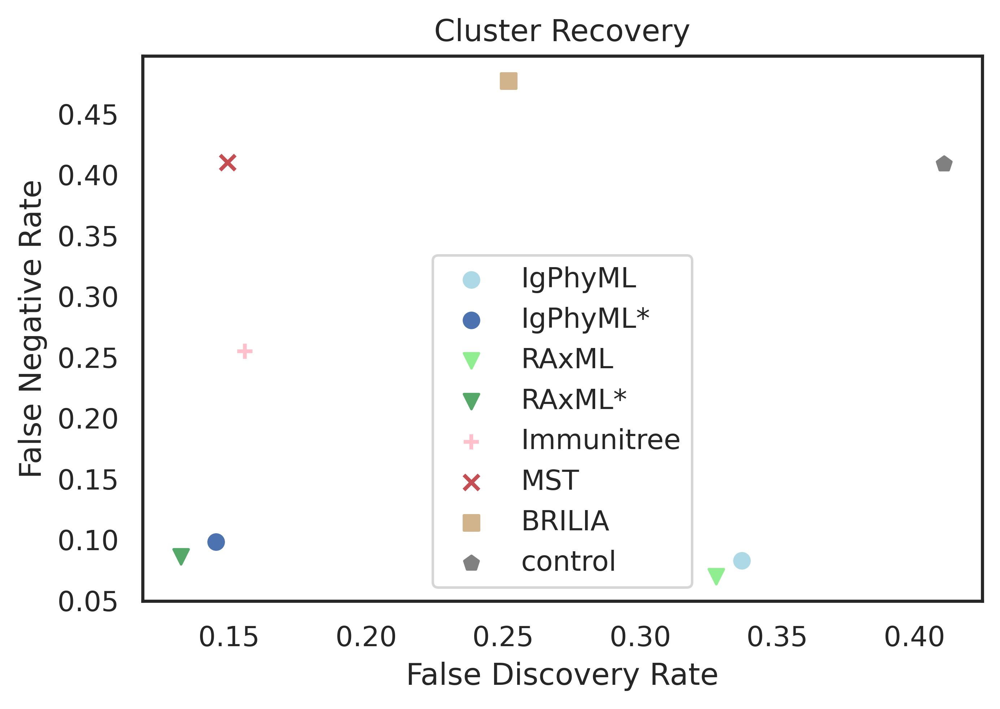

In [429]:
with sns.axes_style("white"):
    reconstruction = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"]
    labels = ["IgPhyML", "IgPhyML*", "RAxML", "RAxML*", "Immunitree", "MST", "BRILIA", "control"]
    precisions = [data[ctp][rm]["a1h05"] for rm in reconstruction]
    recalls = [data[ctr][rm]["a1h05"] for rm in reconstruction]
    markers = ["o", "o", "v", "v", "+", "x", "s", "p"]
    colors = ["lightblue", "b", "lightgreen", "g", "pink", "r", "tan", "grey"]
    plots = [plt.scatter(precisions[i], recalls[i], marker=markers[i], c=colors[i], label=labels[i]) for i in range(len(reconstruction))]
    plt.title('Cluster Recovery')
    plt.xlabel('False Discovery Rate')
    plt.ylabel('False Negative Rate')
    plt.legend()
    plt.savefig("cluster_recovery_default.pdf")

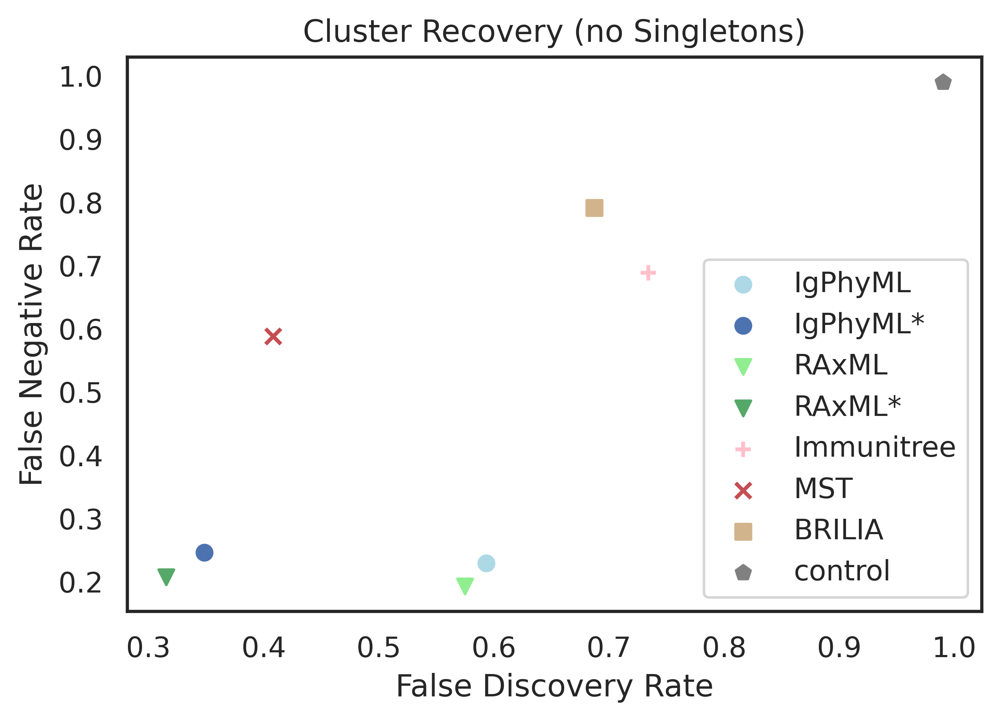

In [390]:
with sns.axes_style("white"):
    reconstruction = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"]
    labels = ["IgPhyML", "IgPhyML*", "RAxML", "RAxML*", "Immunitree", "MST", "BRILIA", "control"]
    precisions = [data[cp][rm]["a1h05"] for rm in reconstruction]
    recalls = [data[cr][rm]["a1h05"] for rm in reconstruction]
    markers = ["o", "o", "v", "v", "+", "x", "s", "p"]
    colors = ["lightblue", "b", "lightgreen", "g", "pink", "r", "tan", "grey"]
    plots = [plt.scatter(precisions[i], recalls[i], marker=markers[i], c=colors[i], label=labels[i]) for i in range(len(reconstruction))]
    plt.title('Cluster Recovery (no Singletons)')
    plt.xlabel('False Discovery Rate')
    plt.ylabel('False Negative Rate')
    plt.legend()
    plt.savefig("cluster_recovery_default_supplement.pdf")

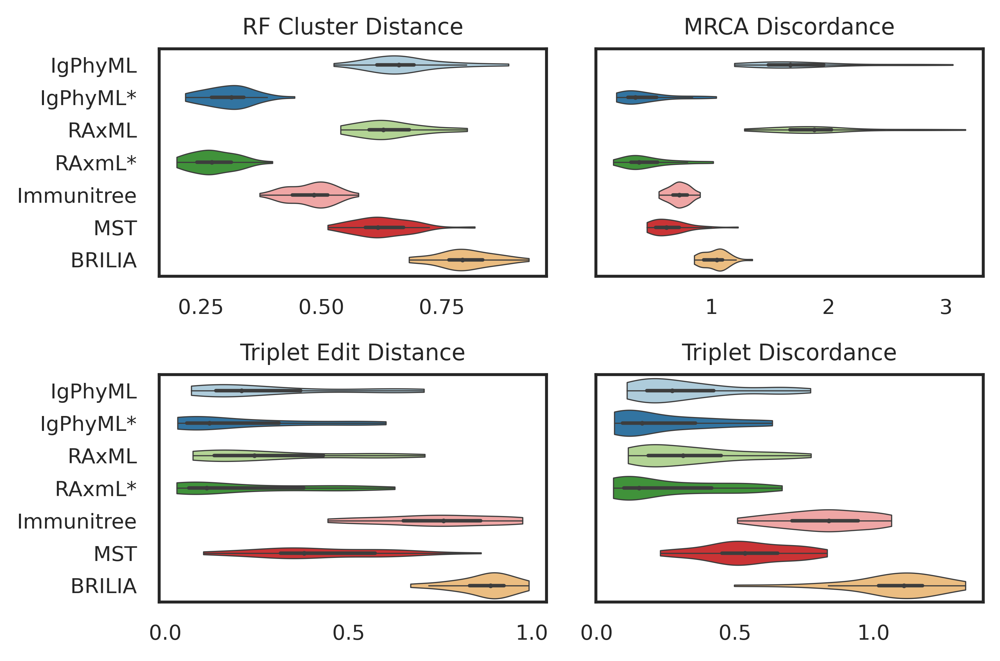

In [391]:
sns.set(font_scale=0.8)
fig = plt.figure()
axes = fig.add_gridspec(2, 2)
fig.tight_layout()
ax = []
with sns.axes_style("white"):
    ax.append(fig.add_subplot(axes[0, 0]))
    ax.append(fig.add_subplot(axes[0, 1], sharey=ax[0]))
    ax.append(fig.add_subplot(axes[1, 0]))
    ax.append(fig.add_subplot(axes[1, 1], sharey=ax[2]))
    plt.setp(ax[1].get_yticklabels(), visible=False)
    plt.setp(ax[3].get_yticklabels(), visible=False)
evaluation = [rft, amrca, dist, tripd]
titles = ["RF Cluster Distance", "MRCA Discordance", "Triplet Edit Distance", "Triplet Discordance"]
reconstruction = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
labels = ["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA"]
sns.set_palette("Paired")
for i in range(4):
    sns.violinplot(data=[list(norm_raw_data[evaluation[i]][rm]["a1h05"].values()) for rm in reconstruction], ax=ax[i], orient="h", linewidth=0.5, cut=0)
    ax[i].set_yticklabels(labels)
    ax[i].set_title(titles[i])
plt.tight_layout()
sns.set(font_scale=1)
plt.savefig("evaluation_default.pdf")

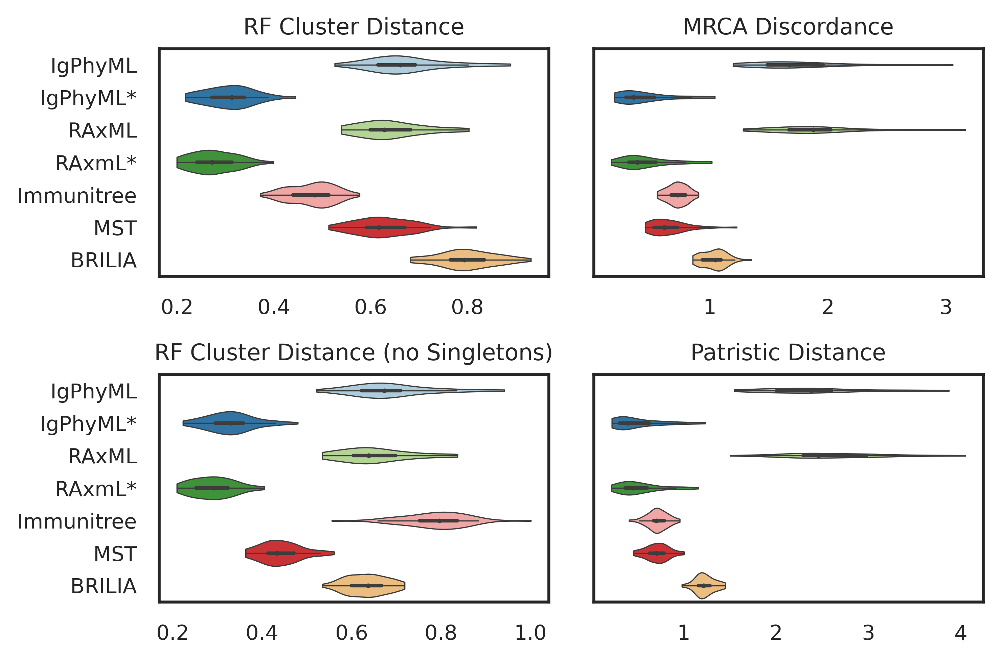

In [392]:
sns.set(font_scale=0.8)
fig = plt.figure()
axes = fig.add_gridspec(2, 2)
fig.tight_layout()
ax = []
with sns.axes_style("white"):
    ax.append(fig.add_subplot(axes[0, 0]))
    ax.append(fig.add_subplot(axes[0, 1], sharey=ax[0]))
    ax.append(fig.add_subplot(axes[1, 0]))
    ax.append(fig.add_subplot(axes[1, 1], sharey=ax[2]))
    plt.setp(ax[1].get_yticklabels(), visible=False)
    plt.setp(ax[3].get_yticklabels(), visible=False)
evaluation = [rft, amrca, rf, mrca]
titles = ["RF Cluster Distance", "MRCA Discordance", "RF Cluster Distance (no Singletons)", "Patristic Distance"]
reconstruction = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
labels = ["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA"]
sns.set_palette("Paired")
for i in range(4):
    sns.violinplot(data=[list(norm_raw_data[evaluation[i]][rm]["a1h05"].values()) for rm in reconstruction], ax=ax[i], orient="h", linewidth=0.5, cut=0)
    ax[i].set_yticklabels(labels)
    ax[i].set_title(titles[i])
plt.tight_layout()
sns.set(font_scale=1)
plt.savefig("evaluation_default_supplement.pdf")

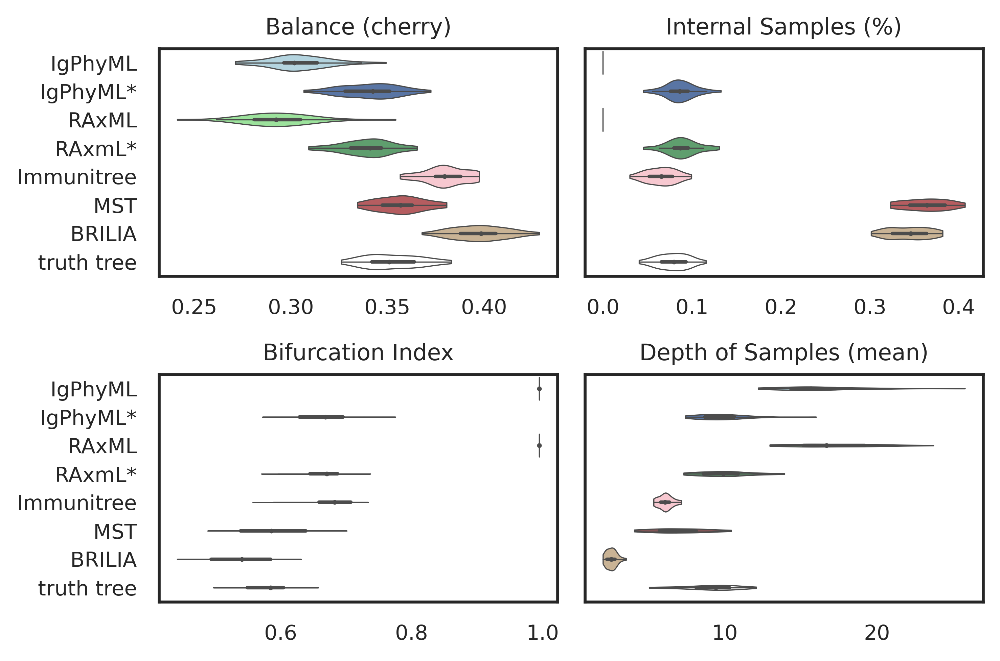

In [393]:
sns.set(font_scale=0.8)
fig = plt.figure()
axes = fig.add_gridspec(2, 2)
fig.tight_layout()
ax = []
with sns.axes_style("white"):
    ax.append(fig.add_subplot(axes[0, 0]))
    ax.append(fig.add_subplot(axes[0, 1], sharey=ax[0]))
    ax.append(fig.add_subplot(axes[1, 0]))
    ax.append(fig.add_subplot(axes[1, 1], sharey=ax[2]))
    plt.setp(ax[1].get_yticklabels(), visible=False)
    plt.setp(ax[3].get_yticklabels(), visible=False)
evaluation = [cherry, ilabel, inode, meanh]
titles = ["Balance (cherry)", "Internal Samples (%)", "Bifurcation Index", "Depth of Samples (mean)"]
reconstruction = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "truth"]
labels = ["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "truth tree"]
sns.set_palette(["lightblue", "b", "lightgreen", "g", "pink", "r", "tan", "white"])
for i in range(4):
    sns.violinplot(data=[list(norm_raw_data[evaluation[i]][rm]["a1h05"].values()) for rm in reconstruction], ax=ax[i], orient="h", linewidth=0.5, cut=0)
    ax[i].set_yticklabels(labels)
    ax[i].set_title(titles[i])
plt.tight_layout()
sns.set(font_scale=1)
plt.savefig("property_default.pdf")

# Selective Pressure & Mutation Rate together

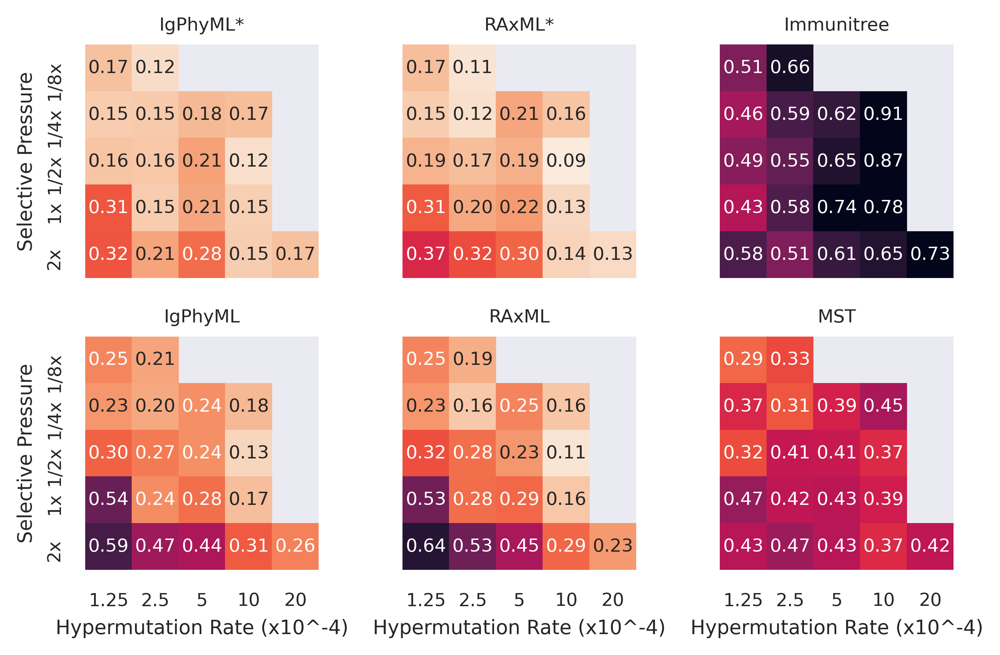

In [394]:
sns.set(font_scale=0.7)
fig, axes = plt.subplots(2, 3, sharey=True, sharex=True)
plot_heatmap(dist, "igphyml+", title="IgPhyML*", plot=axes[0, 0], font_scale=0.65, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "GTR+", title="RAxML*", plot=axes[0, 1], font_scale=0.65, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "immunitree", title="Immunitree", plot=axes[0, 2], font_scale=0.65, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "igphyml", title="IgPhyML", plot=axes[1, 0], font_scale=0.65, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "GTR", title="RAxML", plot=axes[1, 1], font_scale=0.65, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "mst", title="MST", plot=axes[1, 2], font_scale=0.65, vmin=0.1, vmax=0.7)
sns.set(font_scale=0.7)
axes[0, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 1].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 2].set_xlabel("Hypermutation Rate (x10^-4)")
plt.tight_layout()
sns.set(font_scale=1)
plt.savefig("dist_affinity_hypermutation.pdf")

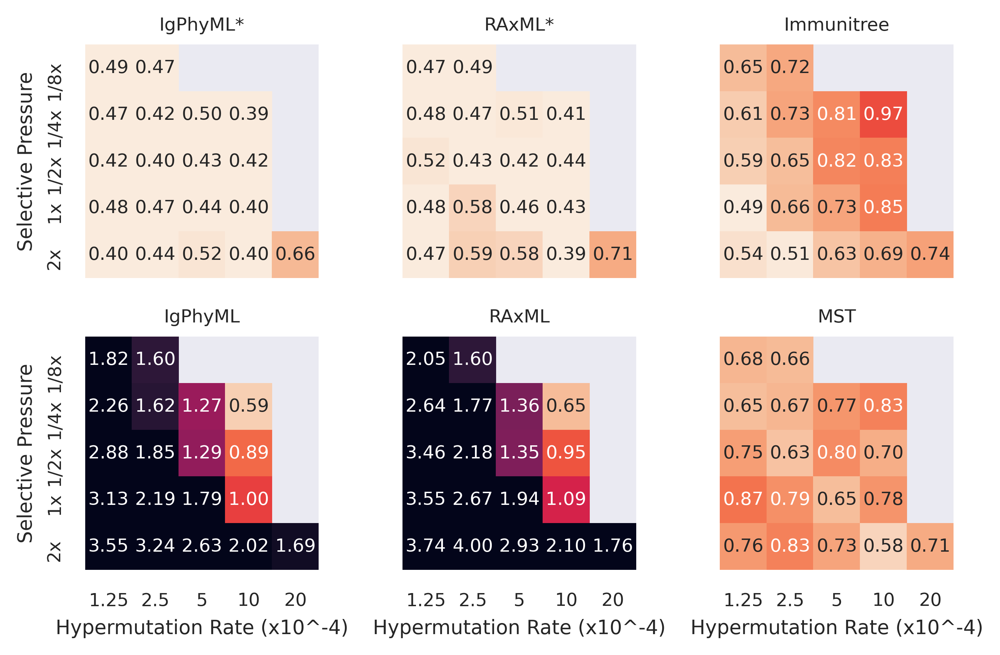

In [395]:
sns.set(font_scale=0.7)
fig, axes = plt.subplots(2, 3, sharey=True, sharex=True)
plot_heatmap(amrca, "igphyml+", title="IgPhyML*", plot=axes[0, 0], font_scale=0.65, vmin=0.5, vmax=1.75)
plot_heatmap(amrca, "GTR+", title="RAxML*", plot=axes[0, 1], font_scale=0.65, vmin=0.5, vmax=1.75)
plot_heatmap(amrca, "immunitree", title="Immunitree", plot=axes[0, 2], font_scale=0.65, vmin=0.5, vmax=1.75)
plot_heatmap(amrca, "igphyml", title="IgPhyML", plot=axes[1, 0], font_scale=0.65, vmin=0.5, vmax=1.75)
plot_heatmap(amrca, "GTR", title="RAxML", plot=axes[1, 1], font_scale=0.65, vmin=0.5, vmax=1.75)
plot_heatmap(amrca, "mst", title="MST", plot=axes[1, 2], font_scale=0.65, vmin=0.5, vmax=1.75)
sns.set(font_scale=0.7)
axes[0, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 1].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 2].set_xlabel("Hypermutation Rate (x10^-4)")
plt.tight_layout()
sns.set(font_scale=1)
plt.savefig("amrca_affinity_hypermutation.pdf")

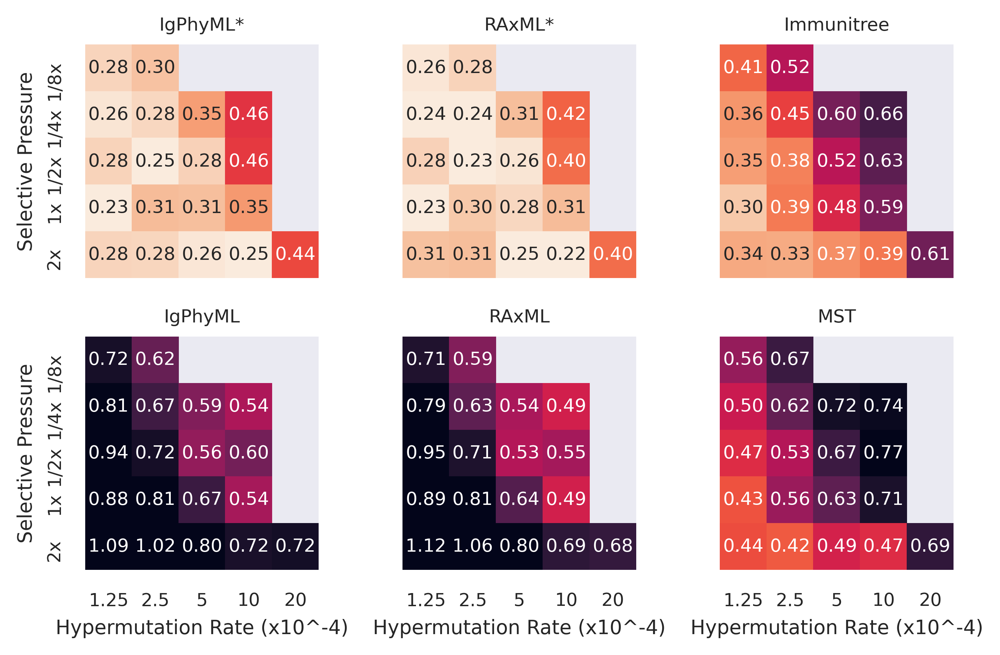

In [396]:
sns.set(font_scale=0.7)
fig, axes = plt.subplots(2, 3, sharey=True, sharex=True)
plot_heatmap(rft, "igphyml+", title="IgPhyML*", plot=axes[0, 0], font_scale=0.65, vmin=0.25, vmax=0.75)
plot_heatmap(rft, "GTR+", title="RAxML*", plot=axes[0, 1], font_scale=0.65, vmin=0.25, vmax=0.75)
plot_heatmap(rft, "immunitree", title="Immunitree", plot=axes[0, 2], font_scale=0.65, vmin=0.25, vmax=0.75)
plot_heatmap(rft, "igphyml", title="IgPhyML", plot=axes[1, 0], font_scale=0.65, vmin=0.25, vmax=0.75)
plot_heatmap(rft, "GTR", title="RAxML", plot=axes[1, 1], font_scale=0.65, vmin=0.25, vmax=0.75)
plot_heatmap(rft, "mst", title="MST", plot=axes[1, 2], font_scale=0.65, vmin=0.25, vmax=0.75)
sns.set(font_scale=0.7)
axes[0, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 1].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 2].set_xlabel("Hypermutation Rate (x10^-4)")
plt.tight_layout()
sns.set(font_scale=1)
plt.savefig("rf_affinity_hypermutation.pdf")

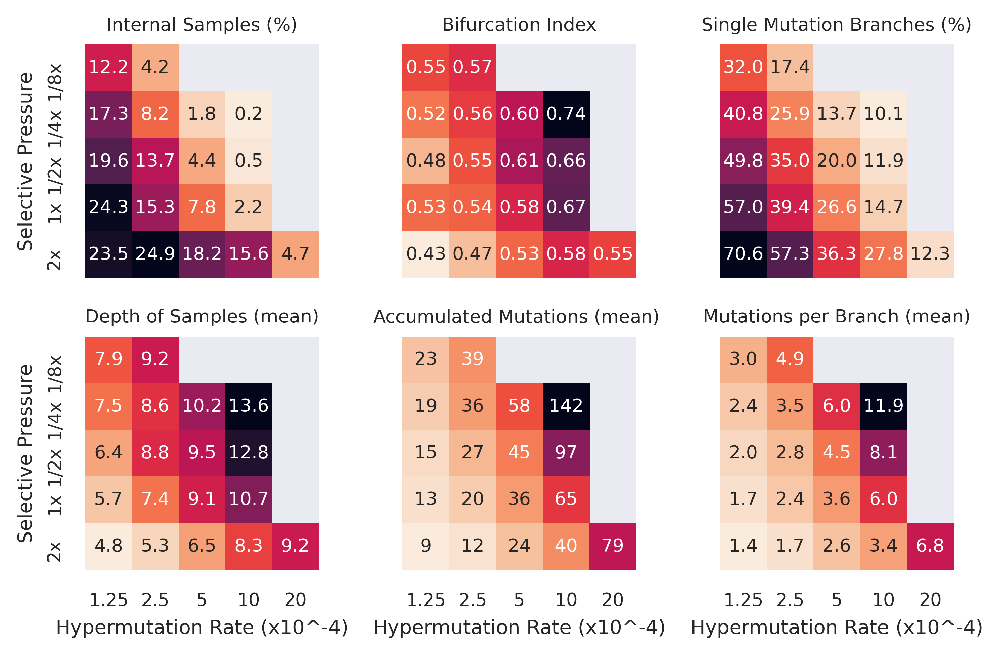

In [397]:
# cherry, ilabel, inode, maxh, meanh, maxhw, meanhw, blw, maxhp, meanhp, blp, lb
sns.set(font_scale=0.7)
fig, axes = plt.subplots(2, 3, sharey=True, sharex=True)
plot_heatmap(ilabel, "truth", title="Internal Samples (%)", plot=axes[0, 0], font_scale=0.65, multiplier=100, fmt="%.1f")
plot_heatmap(inode, "truth", title="Bifurcation Index", plot=axes[0, 1], font_scale=0.65, fmt="%.2f")
plot_heatmap(meanh, "truth", title="Depth of Samples (mean)", plot=axes[1, 0], font_scale=0.65, fmt="%.1f")
plot_heatmap(sb, "truth", title="Single Mutation Branches (%)", plot=axes[0, 2], font_scale=0.65, multiplier=100, fmt="%.1f")
plot_heatmap(meanhw, "truth", title="Accumulated Mutations (mean) ", plot=axes[1, 1], font_scale=0.65, fmt="%.0f")
plot_heatmap(ablw, "truth", title="Mutations per Branch (mean)", plot=axes[1, 2], font_scale=0.65, fmt="%.1f")
sns.set(font_scale=0.7)
axes[0, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 1].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 2].set_xlabel("Hypermutation Rate (x10^-4)")
plt.tight_layout()
sns.set(font_scale=1)
plt.savefig("property_affinity_hypermutation.pdf")

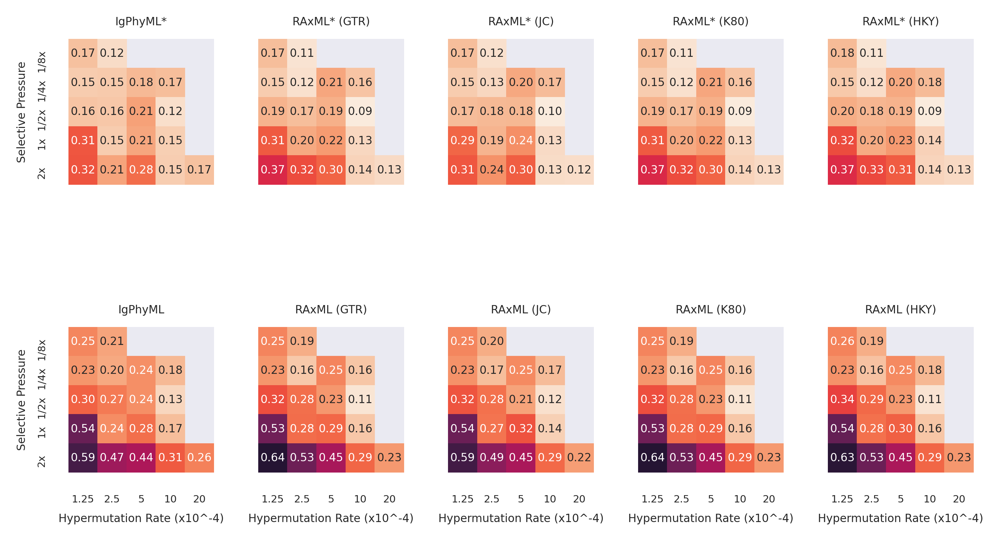

In [398]:
#appendix
sns.set(font_scale=0.4)
fig, axes = plt.subplots(2, 5, sharey=True, sharex=True)
plot_heatmap(dist, "igphyml+", title="IgPhyML*", plot=axes[0, 0], font_scale=0.4, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "GTR+", title="RAxML* (GTR)", plot=axes[0, 1], font_scale=0.4, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "JC+", title="RAxML* (JC)", plot=axes[0, 2], font_scale=0.4, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "K80+", title="RAxML* (K80)", plot=axes[0, 3], font_scale=0.4, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "HKY+", title="RAxML* (HKY)", plot=axes[0, 4], font_scale=0.4, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "igphyml", title="IgPhyML", plot=axes[1, 0], font_scale=0.4, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "GTR", title="RAxML (GTR)", plot=axes[1, 1], font_scale=0.4, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "JC", title="RAxML (JC)", plot=axes[1, 2], font_scale=0.4, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "K80", title="RAxML (K80)", plot=axes[1, 3], font_scale=0.4, vmin=0.1, vmax=0.7)
plot_heatmap(dist, "HKY", title="RAxML (HKY)", plot=axes[1, 4], font_scale=0.4, vmin=0.1, vmax=0.7)
sns.set(font_scale=0.4)
axes[0, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_ylabel("Selective Pressure")
axes[1, 0].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 1].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 2].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 3].set_xlabel("Hypermutation Rate (x10^-4)")
axes[1, 4].set_xlabel("Hypermutation Rate (x10^-4)")
plt.tight_layout()
sns.set(font_scale=1)
plt.savefig("igphyml_affinity_hypermutation.pdf")

# Selective Pressure

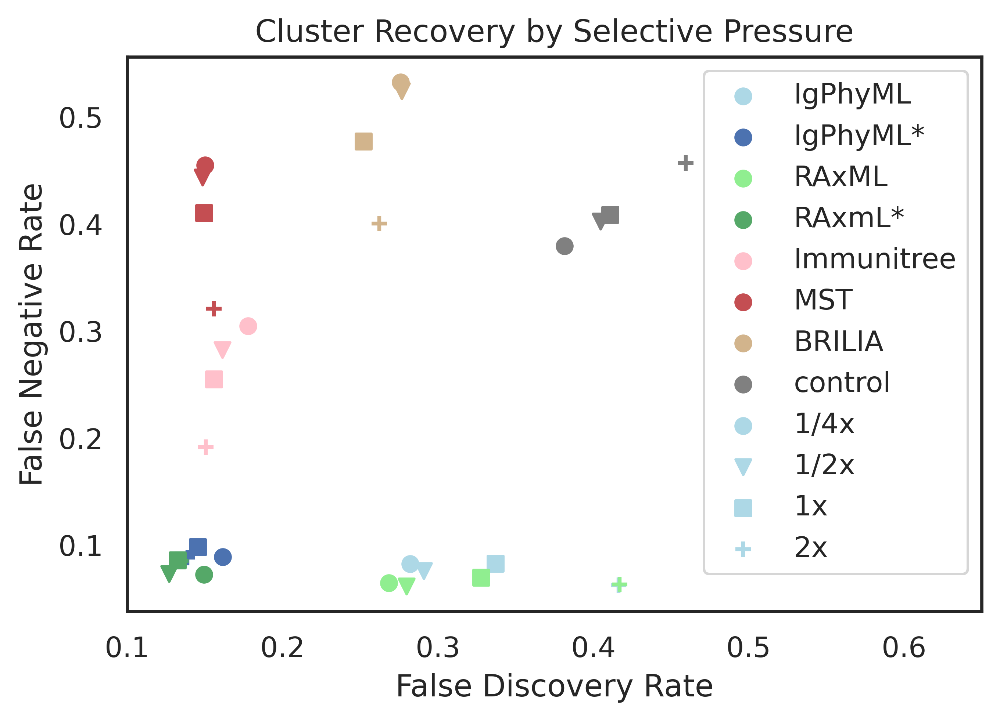

In [427]:
with sns.axes_style("white"):
    plt.xlim(0.1, 0.65)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["a025h05","a05h05","a1h05","a2h05"], True,
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["1/4x","1/2x","1x","2x"],
                          colors = ["lightblue", "b", "lightgreen", "g", "pink", "r", "tan", "grey"],
                          title='Cluster Recovery by Selective Pressure')
    plt.savefig("cluster_recovery_affinity.pdf")

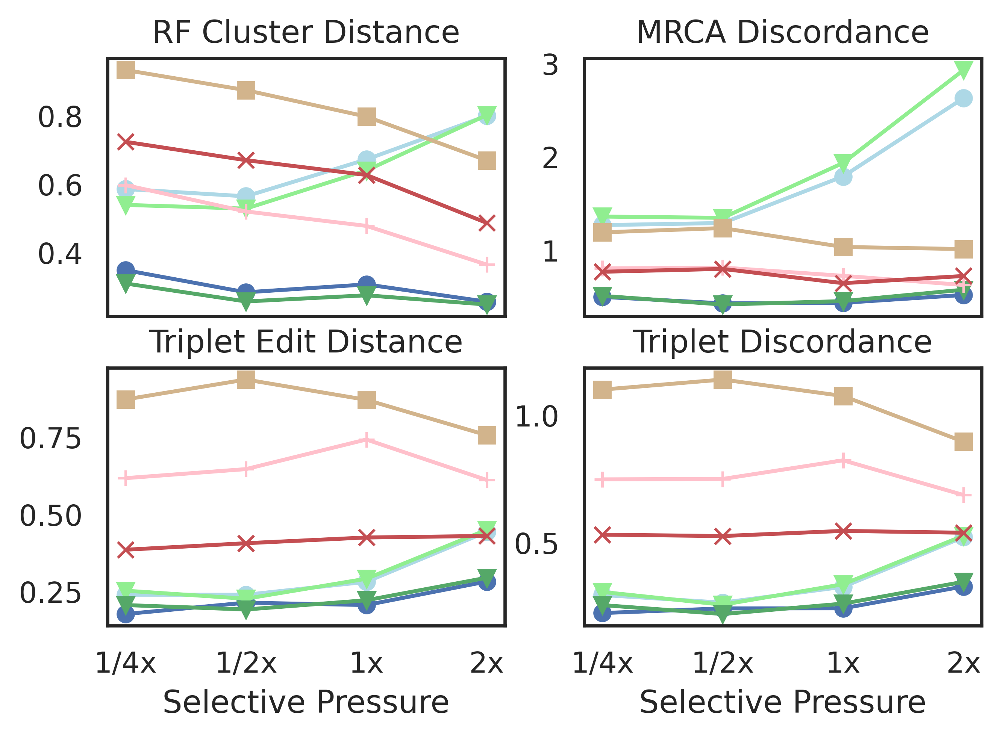

In [400]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["a025h05","a05h05","a1h05","a2h05"]
    conditionLabels = ["1/4x","1/2x","1x","2x"]
    plot_line_graph(rft, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="RF Cluster Distance", conditionLabels=conditionLabels)
    plot_line_graph(amrca, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="MRCA Discordance", conditionLabels=conditionLabels)
    plot_line_graph(dist, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Triplet Edit Distance", conditionLabels=conditionLabels)
    plot_line_graph(tripd, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Triplet Discordance", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Selective Pressure")
    axes[1, 1].set_xlabel("Selective Pressure")
    plt.savefig("evaluation_affinity.pdf")

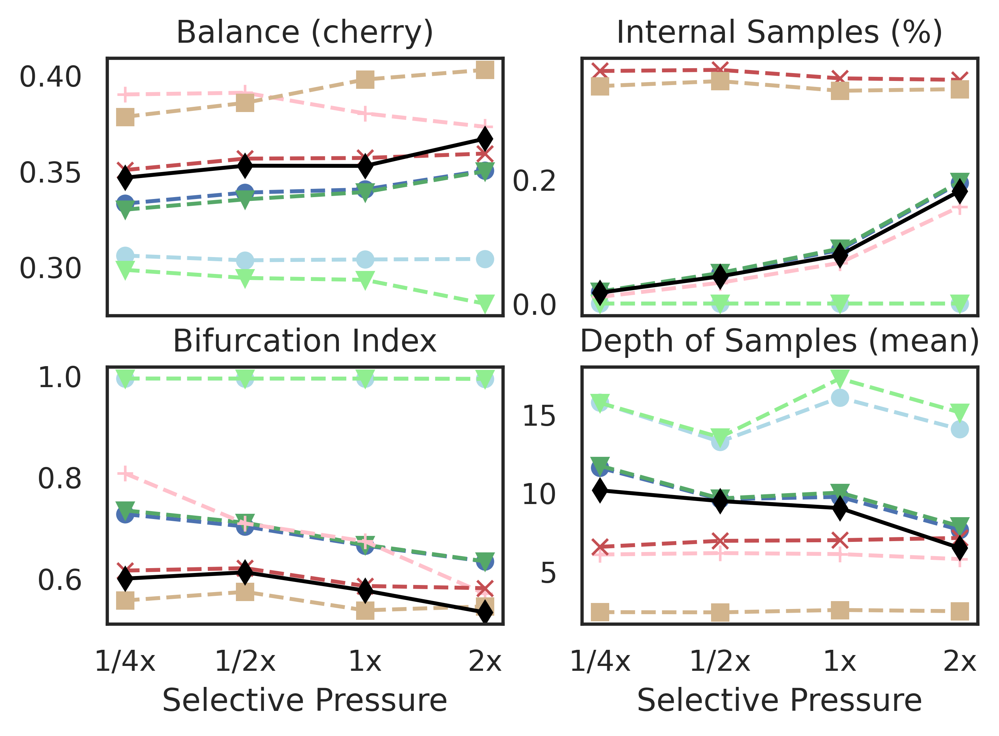

In [401]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "truth"]
    condition = ["a025h05","a05h05","a1h05","a2h05"]
    conditionLabels = ["1/4x","1/2x","1x","2x"]
    plot_line_graph(cherry, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="Balance (cherry)", conditionLabels=conditionLabels)
    plot_line_graph(ilabel, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="Internal Samples (%)", conditionLabels=conditionLabels)
    plot_line_graph(inode, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Bifurcation Index", conditionLabels=conditionLabels)
    plot_line_graph(meanh, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Depth of Samples (mean)", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Selective Pressure")
    axes[1, 1].set_xlabel("Selective Pressure")
    plt.savefig("property_affinity.pdf")

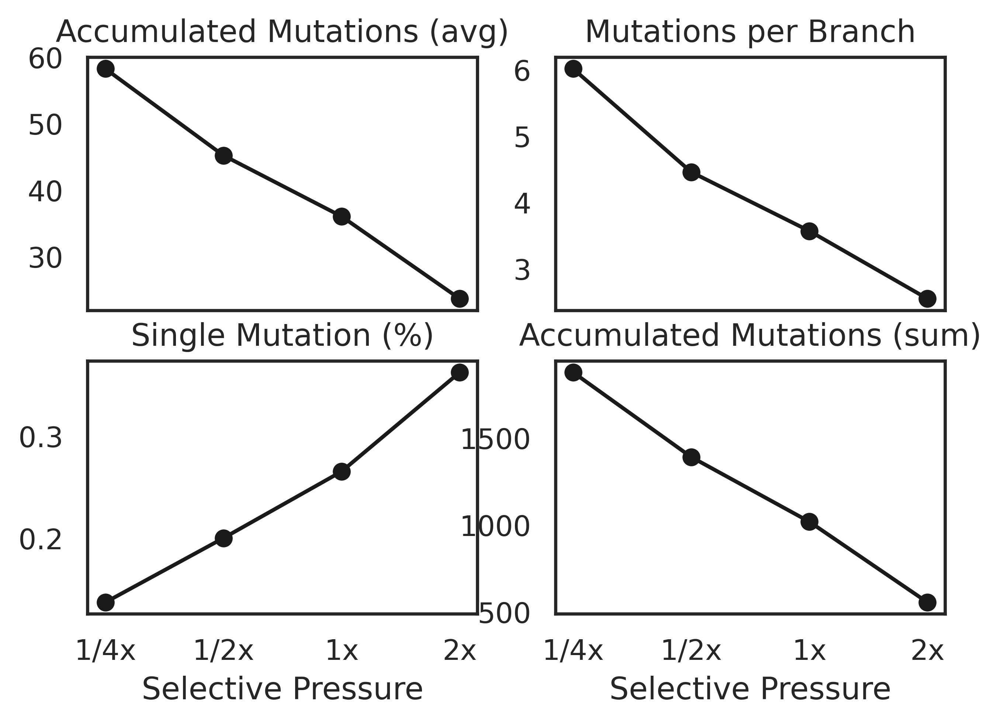

In [402]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    condition = ["a025h05","a05h05","a1h05","a2h05"]
    conditionLabels = ["1/4x","1/2x","1x","2x"]
    plot_line_graph(meanhw, ["truth"], condition, plot=axes[0, 0], showlegend=False, title="Accumulated Mutations (avg)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(ablw, ["truth"], condition, plot=axes[0, 1], showlegend=False, title="Mutations per Branch", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(sb, ["truth"], condition, plot=axes[1, 0], showlegend=False, title="Single Mutation (%)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(blw, ["truth"], condition, plot=axes[1, 1], showlegend=False, title="Accumulated Mutations (sum)", colors=["k"], conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Selective Pressure")
    axes[1, 1].set_xlabel("Selective Pressure")
    plt.savefig("property_true_affinity.pdf")

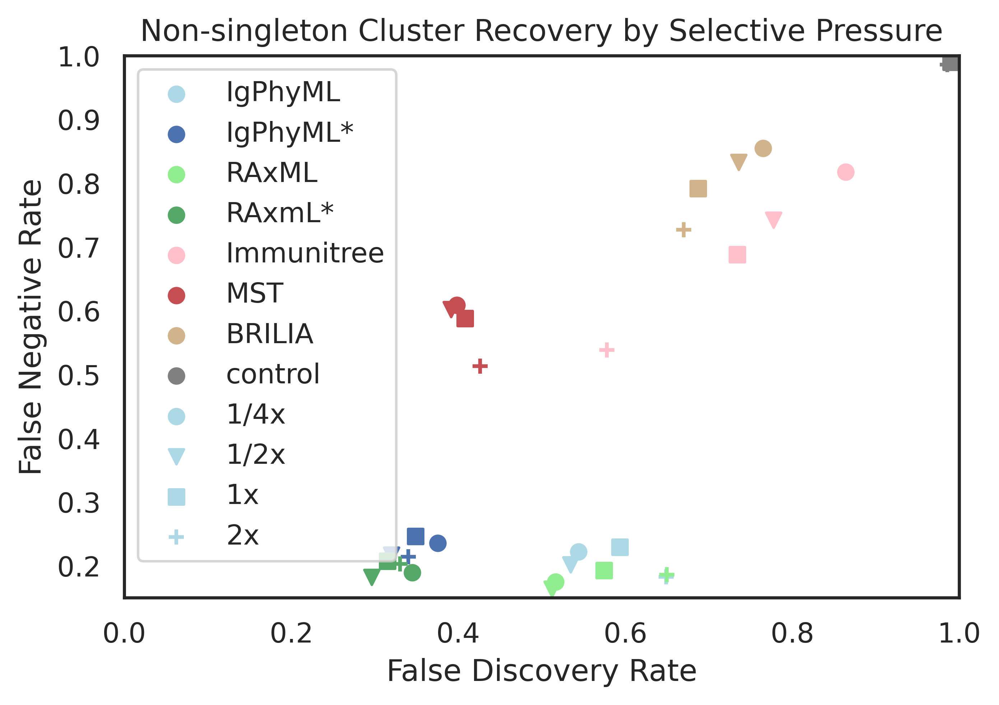

In [437]:
#appendix
with sns.axes_style("white"):
    plt.xlim(0, 1)
    plt.ylim(0.15, 1)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["a025h05","a05h05","a1h05","a2h05"],
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["1/4x","1/2x","1x","2x"],
                          title='Non-singleton Cluster Recovery by Selective Pressure')
    plt.savefig("cluster_recovery_affinity_supplement.pdf")

# Mutation Rate

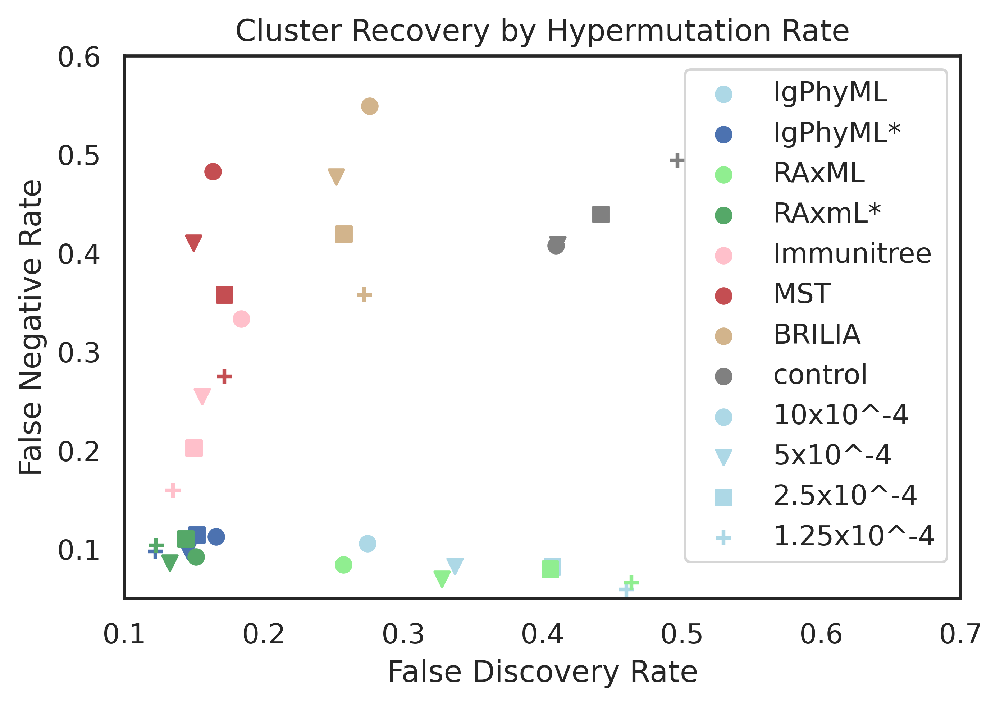

In [489]:
with sns.axes_style("white"):
    plt.xlim(0.1, 0.7)
    plt.ylim(0.05, 0.6)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["a1h1","a1h05","a1h025","a1h0125"], True,
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["10x10^-4","5x10^-4","2.5x10^-4","1.25x10^-4"],
                          title='Cluster Recovery by Hypermutation Rate')
    plt.savefig("cluster_recovery_mutation.pdf")

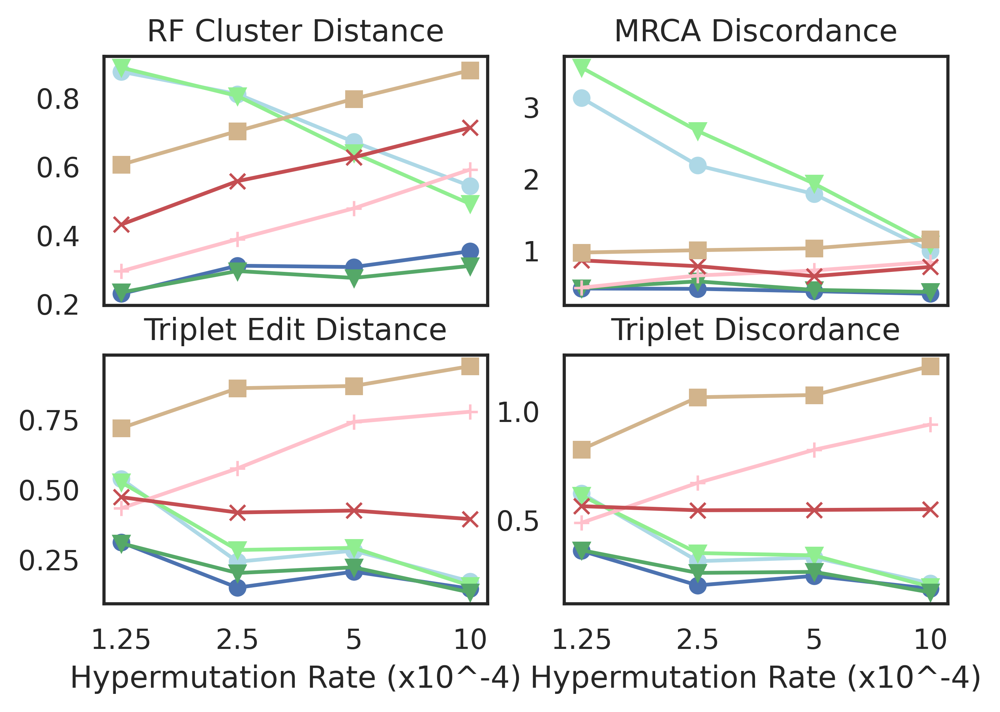

In [405]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["a1h0125","a1h025","a1h05","a1h1"]
    conditionLabels = ["1.25","2.5","5","10"]
    plot_line_graph(rft, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="RF Cluster Distance", conditionLabels=conditionLabels)
    plot_line_graph(amrca, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="MRCA Discordance", conditionLabels=conditionLabels)
    plot_line_graph(dist, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Triplet Edit Distance", conditionLabels=conditionLabels)
    plot_line_graph(tripd, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Triplet Discordance", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Hypermutation Rate (x10^-4)")
    axes[1, 1].set_xlabel("Hypermutation Rate (x10^-4)")
    plt.savefig("evaluation_mutation.pdf")

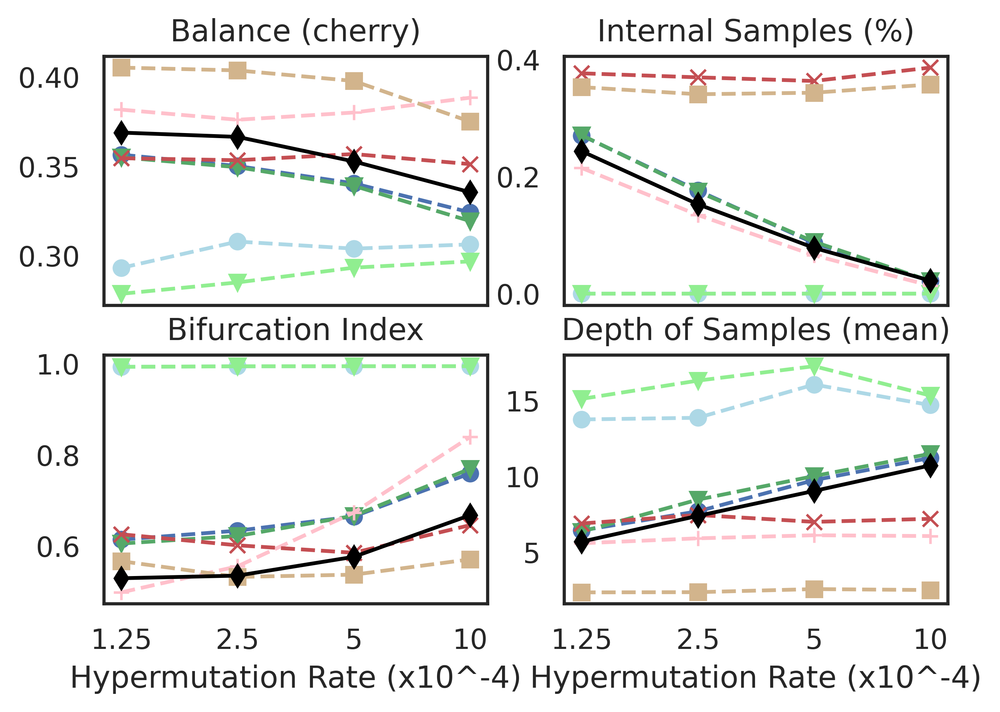

In [406]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "truth"]
    condition = ["a1h0125","a1h025","a1h05","a1h1"]
    conditionLabels = ["1.25","2.5","5","10"]
    plot_line_graph(cherry, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="Balance (cherry)", conditionLabels=conditionLabels)
    plot_line_graph(ilabel, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="Internal Samples (%)", conditionLabels=conditionLabels)
    plot_line_graph(inode, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Bifurcation Index", conditionLabels=conditionLabels)
    plot_line_graph(meanh, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Depth of Samples (mean)", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Hypermutation Rate (x10^-4)")
    axes[1, 1].set_xlabel("Hypermutation Rate (x10^-4)")
    plt.savefig("property_mutation.pdf")

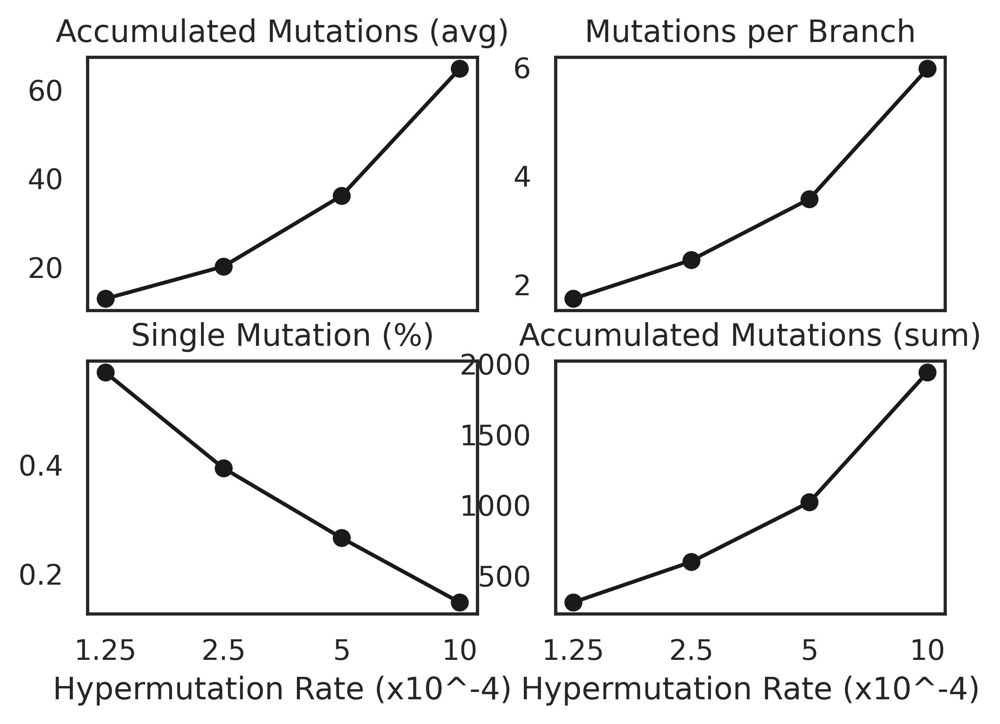

In [407]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    condition = ["a1h0125","a1h025","a1h05","a1h1"]
    conditionLabels = ["1.25","2.5","5","10"]
    plot_line_graph(meanhw, ["truth"], condition, plot=axes[0, 0], showlegend=False, title="Accumulated Mutations (avg)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(ablw, ["truth"], condition, plot=axes[0, 1], showlegend=False, title="Mutations per Branch", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(sb, ["truth"], condition, plot=axes[1, 0], showlegend=False, title="Single Mutation (%)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(blw, ["truth"], condition, plot=axes[1, 1], showlegend=False, title="Accumulated Mutations (sum)", colors=["k"], conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Hypermutation Rate (x10^-4)")
    axes[1, 1].set_xlabel("Hypermutation Rate (x10^-4)")
    plt.savefig("property_true_mutation.pdf")

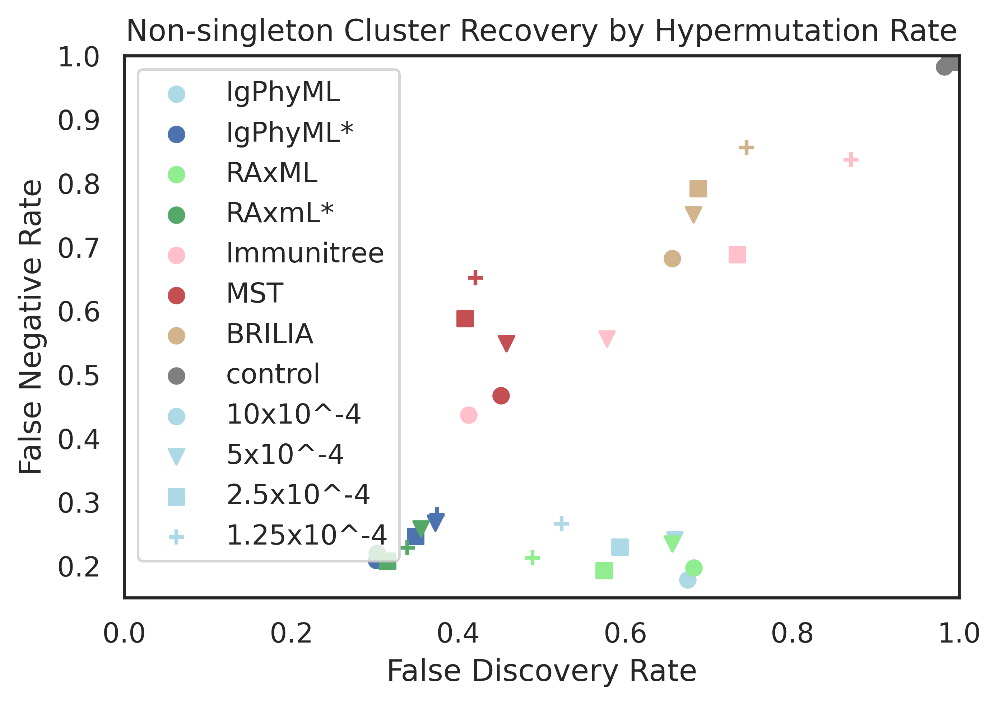

In [438]:
with sns.axes_style("white"):
    plt.xlim(0.0, 1)
    plt.ylim(0.15, 1)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["a1h0125","a1h025","a1h05","a1h1"],
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["10x10^-4","5x10^-4","2.5x10^-4","1.25x10^-4"],
                          title='Non-singleton Cluster Recovery by Hypermutation Rate')
    plt.savefig("cluster_recovery_mutation_supplement.pdf")

# Selective Pressure on Framework Region

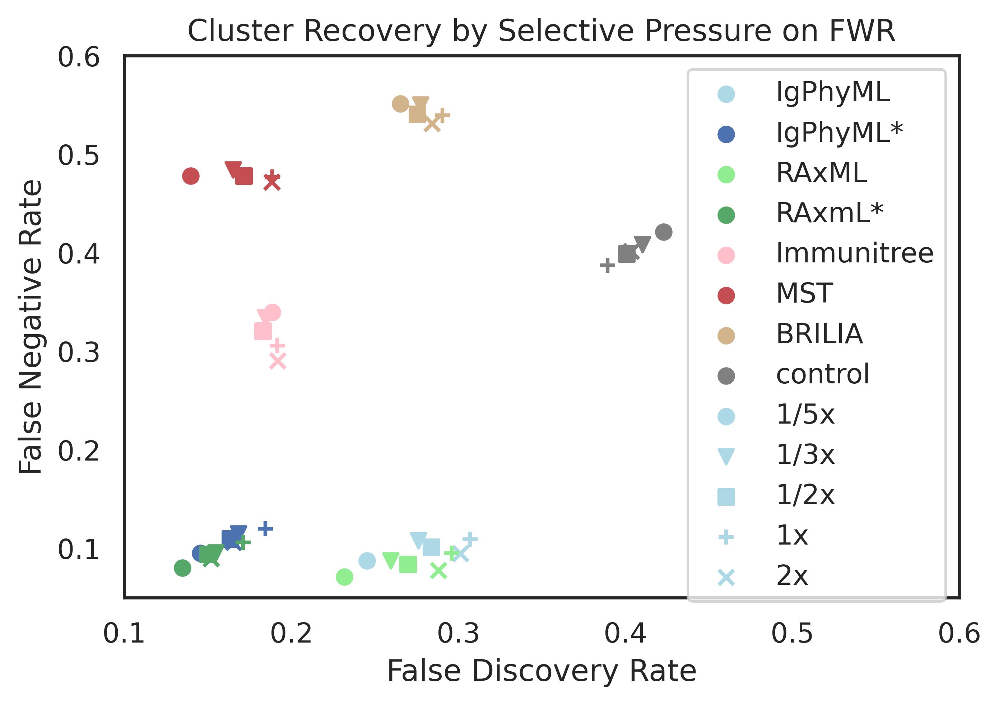

In [439]:
with sns.axes_style("white"):
    plt.xlim(0.1, 0.6)
    plt.ylim(0.05, 0.6)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["fw5","fw3","fw2","fw1", "fw"], True,
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["1/5x","1/3x","1/2x","1x","2x"],
                          title='Cluster Recovery by Selective Pressure on FWR')
    plt.savefig("cluster_recovery_frame.pdf")

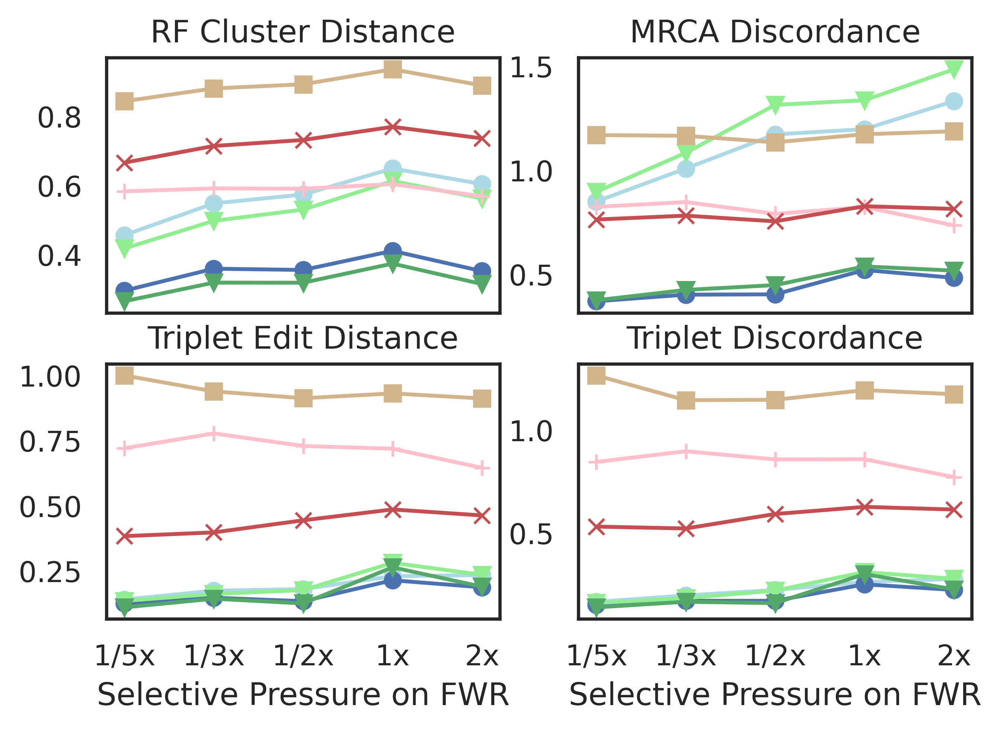

In [410]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["fw5","fw3","fw2","fw1", "fw"]
    conditionLabels = ["1/5x","1/3x","1/2x","1x","2x"]
    plot_line_graph(rft, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="RF Cluster Distance", conditionLabels=conditionLabels)
    plot_line_graph(amrca, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="MRCA Discordance", conditionLabels=conditionLabels)
    plot_line_graph(dist, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Triplet Edit Distance", conditionLabels=conditionLabels)
    plot_line_graph(tripd, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Triplet Discordance", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Selective Pressure on FWR")
    axes[1, 1].set_xlabel("Selective Pressure on FWR")
    plt.savefig("evaluation_frame.pdf")

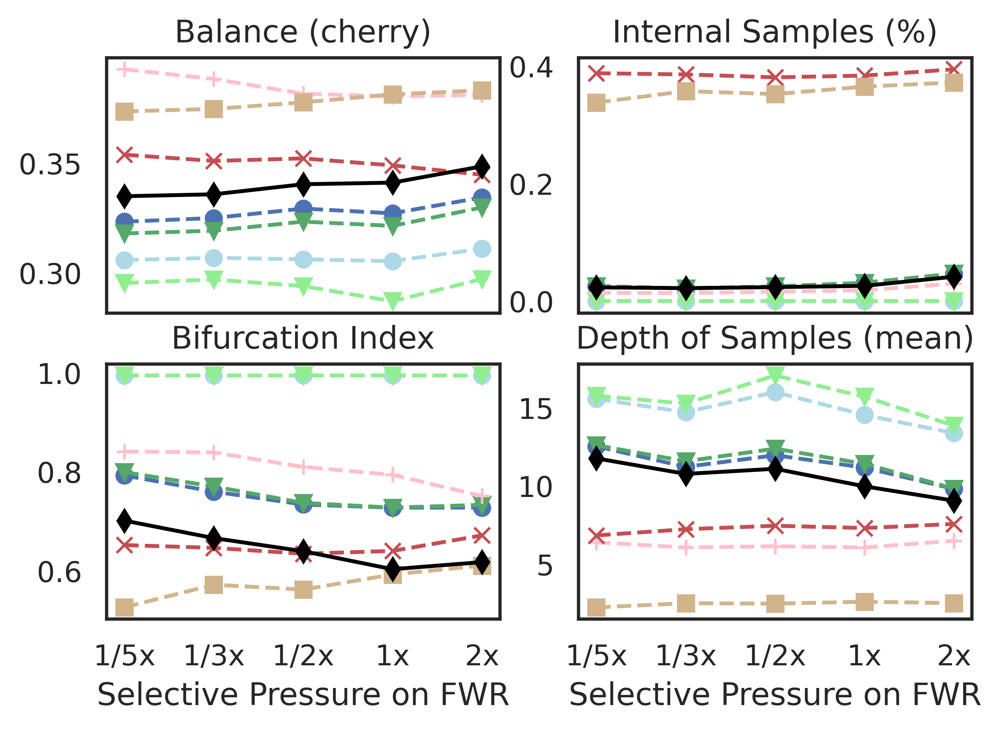

In [411]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "truth"]
    condition = ["fw5","fw3","fw2","fw1", "fw"]
    conditionLabels = ["1/5x","1/3x","1/2x","1x","2x"]
    plot_line_graph(cherry, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="Balance (cherry)", conditionLabels=conditionLabels)
    plot_line_graph(ilabel, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="Internal Samples (%)", conditionLabels=conditionLabels)
    plot_line_graph(inode, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Bifurcation Index", conditionLabels=conditionLabels)
    plot_line_graph(meanh, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Depth of Samples (mean)", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Selective Pressure on FWR")
    axes[1, 1].set_xlabel("Selective Pressure on FWR")
    plt.savefig("property_frame.pdf")

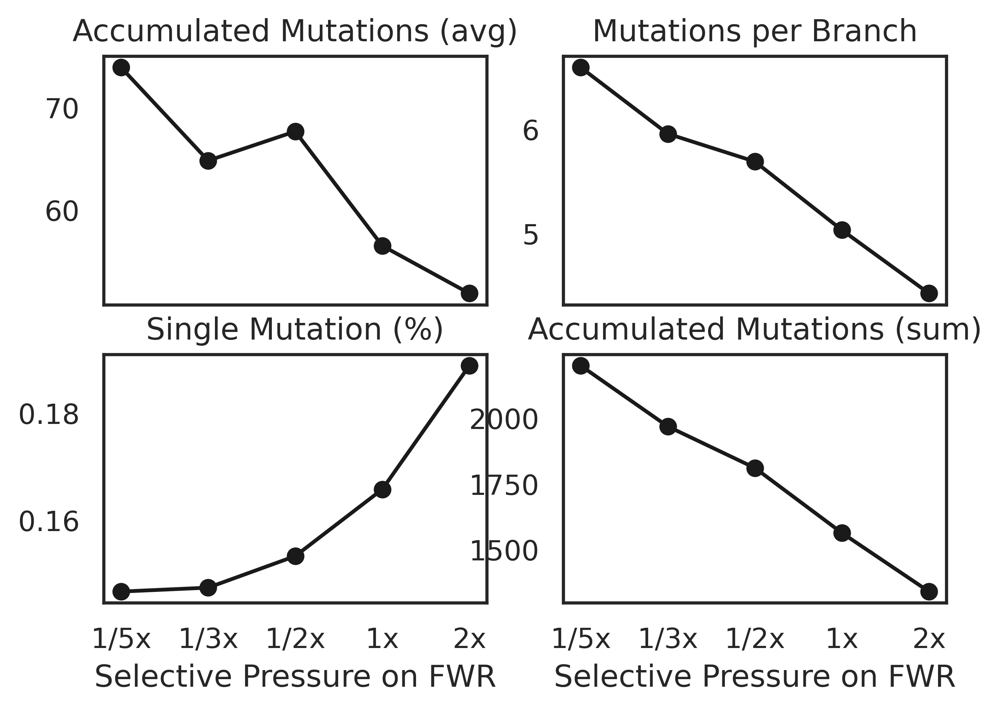

In [412]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    condition = ["fw5","fw3","fw2","fw1", "fw"]
    conditionLabels = ["1/5x","1/3x","1/2x","1x","2x"]
    plot_line_graph(meanhw, ["truth"], condition, plot=axes[0, 0], showlegend=False, title="Accumulated Mutations (avg)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(ablw, ["truth"], condition, plot=axes[0, 1], showlegend=False, title="Mutations per Branch", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(sb, ["truth"], condition, plot=axes[1, 0], showlegend=False, title="Single Mutation (%)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(blw, ["truth"], condition, plot=axes[1, 1], showlegend=False, title="Accumulated Mutations (sum)", colors=["k"], conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Selective Pressure on FWR")
    axes[1, 1].set_xlabel("Selective Pressure on FWR")
    plt.savefig("property_true_frame.pdf")

# Germinal Center Carrying Capacity

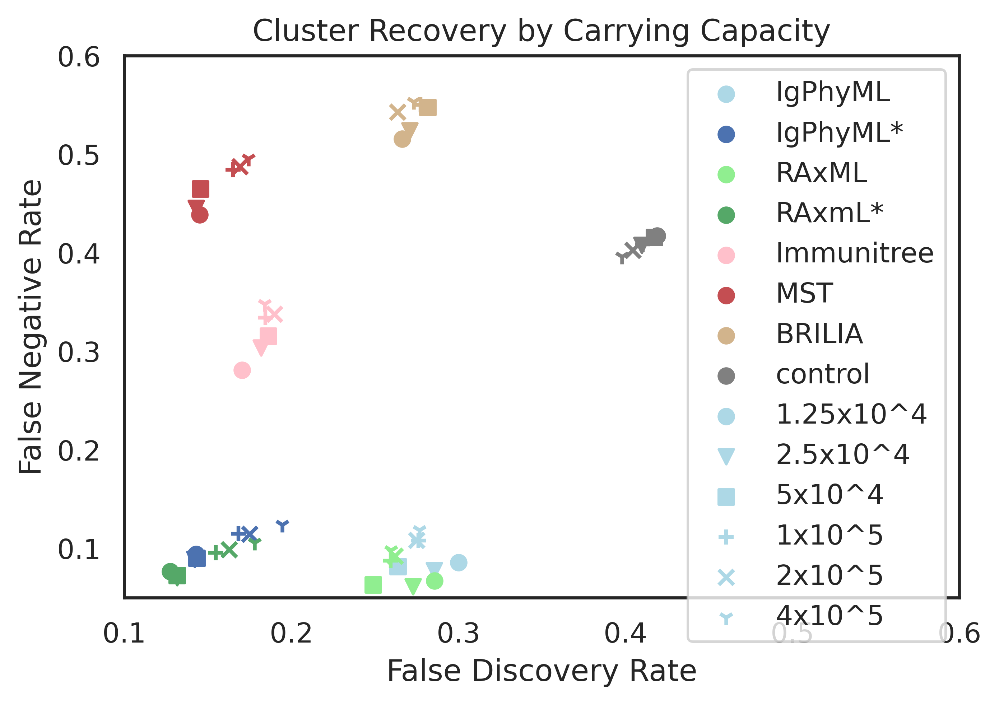

In [440]:
with sns.axes_style("white"):
    plt.xlim(0.1, 0.6)
    plt.ylim(0.05, 0.6)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["gc125","gc250","gc500","gc1000", "gc2000", "gc4000"], True,
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["1.25x10^4","2.5x10^4","5x10^4","1x10^5","2x10^5","4x10^5"],
                          title='Cluster Recovery by Carrying Capacity')
    plt.savefig("cluster_recovery_capacity.pdf")

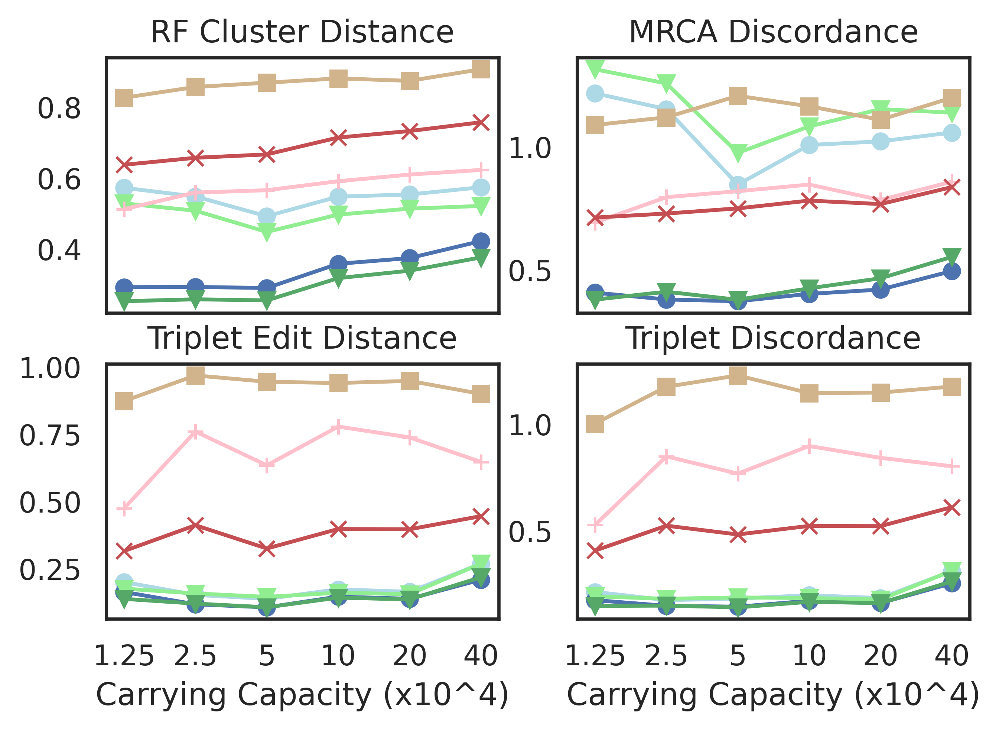

In [414]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["gc125","gc250","gc500","gc1000", "gc2000", "gc4000"]
    conditionLabels = ["1.25","2.5","5","10","20","40"]
    plot_line_graph(rft, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="RF Cluster Distance", conditionLabels=conditionLabels)
    plot_line_graph(amrca, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="MRCA Discordance", conditionLabels=conditionLabels)
    plot_line_graph(dist, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Triplet Edit Distance", conditionLabels=conditionLabels)
    plot_line_graph(tripd, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Triplet Discordance", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Carrying Capacity (x10^4)")
    axes[1, 1].set_xlabel("Carrying Capacity (x10^4)")
    plt.savefig("evaluation_capacity.pdf")

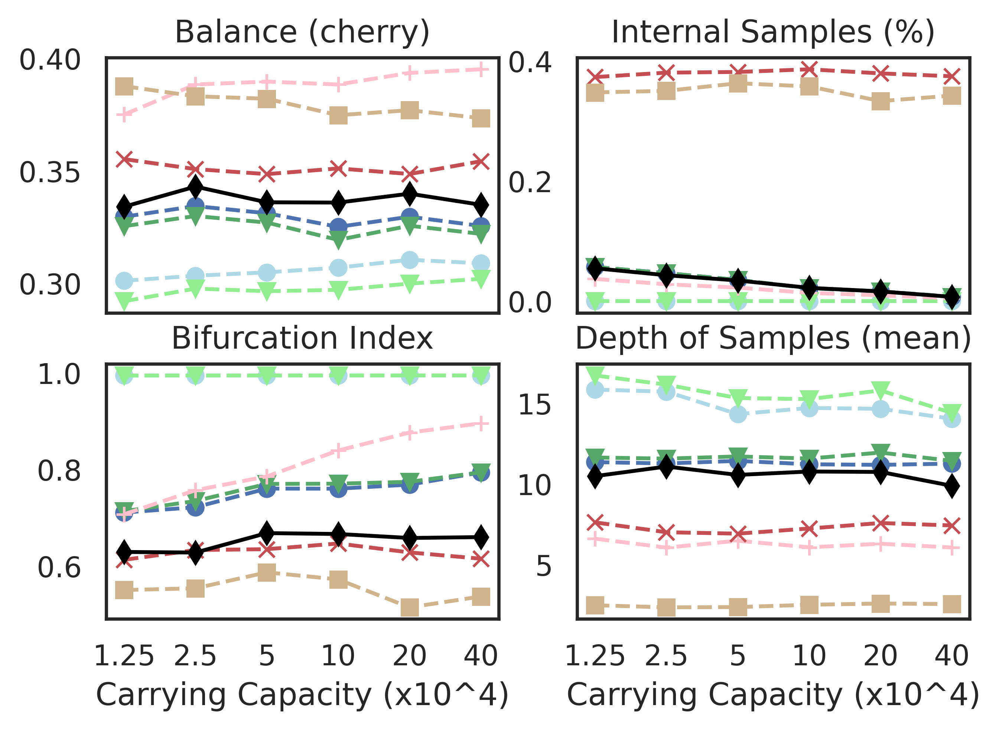

In [415]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "truth"]
    condition = ["gc125","gc250","gc500","gc1000", "gc2000", "gc4000"]
    conditionLabels = ["1.25","2.5","5","10","20","40"]
    plot_line_graph(cherry, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="Balance (cherry)", conditionLabels=conditionLabels)
    plot_line_graph(ilabel, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="Internal Samples (%)", conditionLabels=conditionLabels)
    plot_line_graph(inode, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Bifurcation Index", conditionLabels=conditionLabels)
    plot_line_graph(meanh, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Depth of Samples (mean)", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Carrying Capacity (x10^4)")
    axes[1, 1].set_xlabel("Carrying Capacity (x10^4)")
    plt.savefig("property_capacity.pdf")

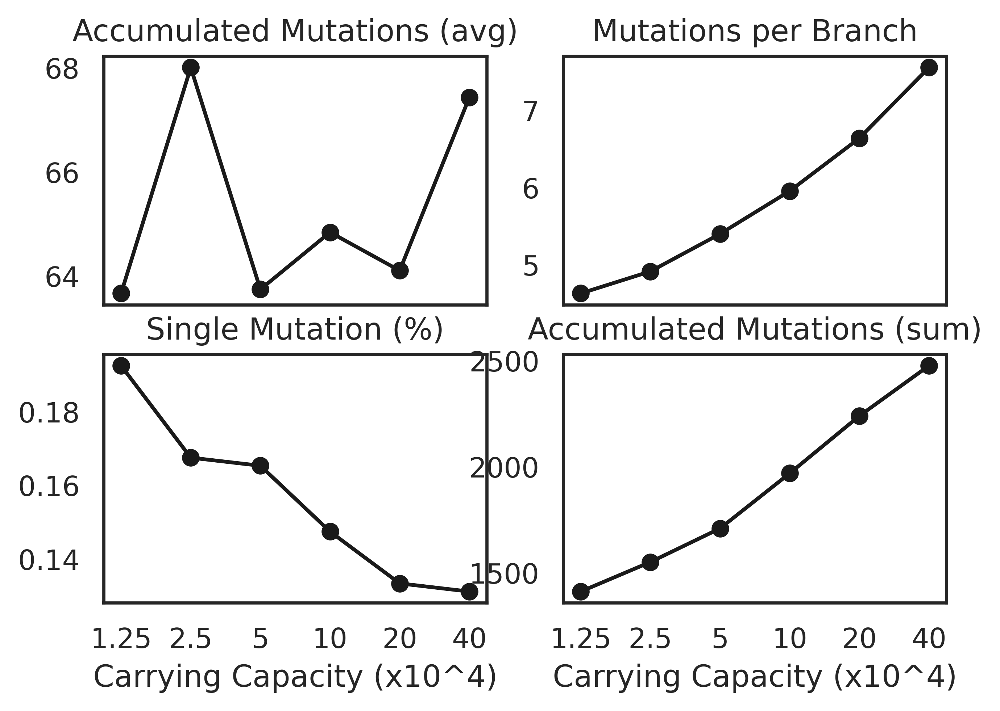

In [416]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["gc125","gc250","gc500","gc1000", "gc2000", "gc4000"]
    conditionLabels = ["1.25","2.5","5","10","20","40"]
    plot_line_graph(meanhw, ["truth"], condition, plot=axes[0, 0], showlegend=False, title="Accumulated Mutations (avg)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(ablw, ["truth"], condition, plot=axes[0, 1], showlegend=False, title="Mutations per Branch", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(sb, ["truth"], condition, plot=axes[1, 0], showlegend=False, title="Single Mutation (%)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(blw, ["truth"], condition, plot=axes[1, 1], showlegend=False, title="Accumulated Mutations (sum)", colors=["k"], conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Carrying Capacity (x10^4)")
    axes[1, 1].set_xlabel("Carrying Capacity (x10^4)")
    plt.savefig("property_true_capacity.pdf")

# Mean-life of Memory Cells

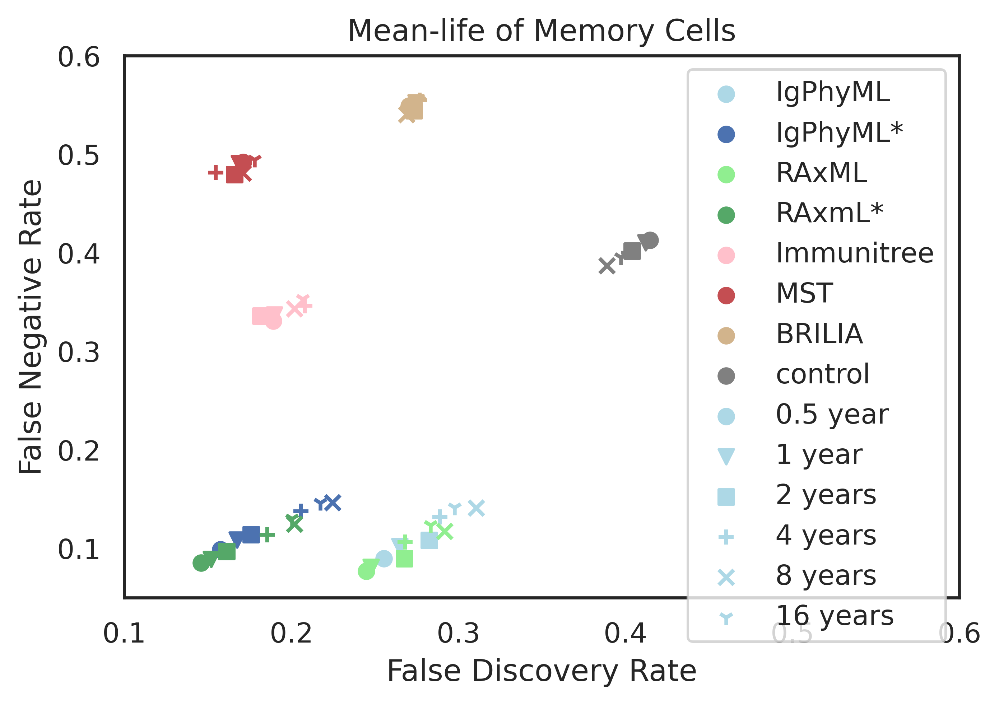

In [441]:
with sns.axes_style("white"):
    plt.xlim(0.1, 0.6)
    plt.ylim(0.05, 0.6)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["hl","hl1","hl2","hl4", "hl8", "hl16"], True,
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["0.5 year","1 year","2 years","4 years","8 years","16 years"],
                          title='Mean-life of Memory Cells')
    plt.savefig("cluster_recovery_life.pdf")

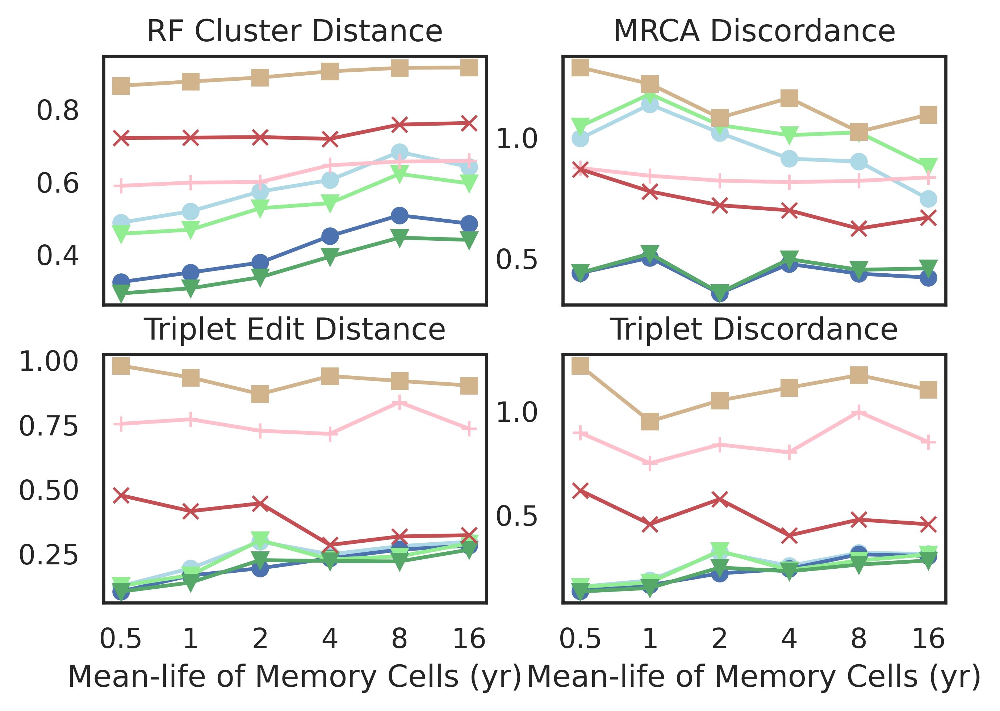

In [418]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["hl","hl1","hl2","hl4", "hl8", "hl16"]
    conditionLabels = ["0.5","1","2","4","8","16"]
    plot_line_graph(rft, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="RF Cluster Distance", conditionLabels=conditionLabels)
    plot_line_graph(amrca, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="MRCA Discordance", conditionLabels=conditionLabels)
    plot_line_graph(dist, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Triplet Edit Distance", conditionLabels=conditionLabels)
    plot_line_graph(tripd, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Triplet Discordance", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Mean-life of Memory Cells (yr)")
    axes[1, 1].set_xlabel("Mean-life of Memory Cells (yr)")
    plt.savefig("evaluation_life.pdf")

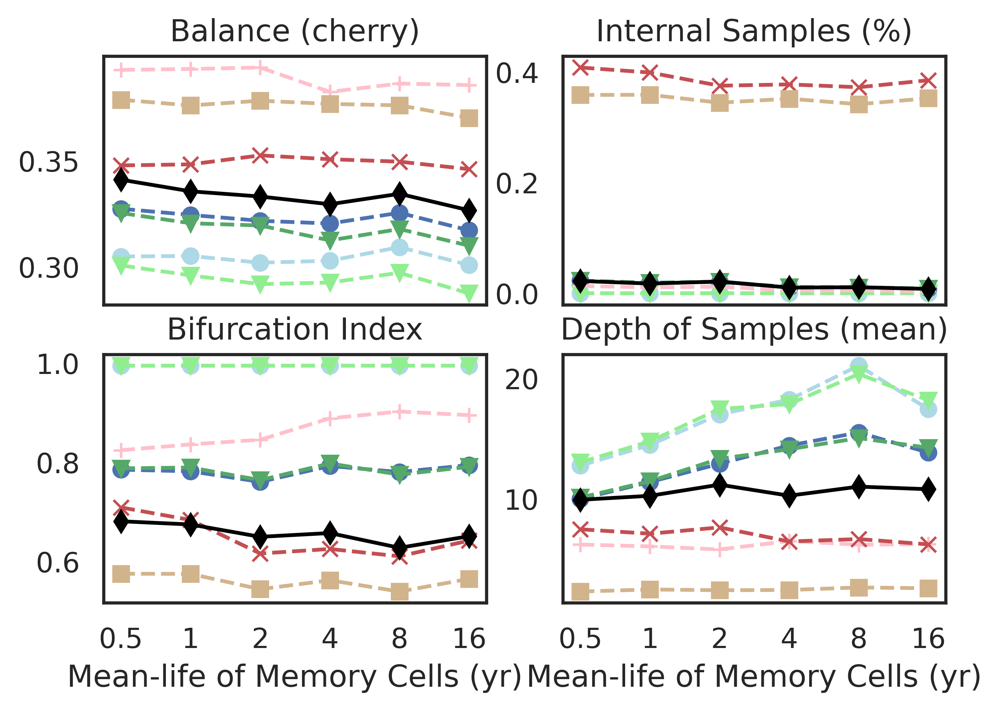

In [419]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "truth"]
    condition = ["hl","hl1","hl2","hl4", "hl8", "hl16"]
    conditionLabels = ["0.5","1","2","4","8","16"]
    plot_line_graph(cherry, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="Balance (cherry)", conditionLabels=conditionLabels)
    plot_line_graph(ilabel, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="Internal Samples (%)", conditionLabels=conditionLabels)
    plot_line_graph(inode, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Bifurcation Index", conditionLabels=conditionLabels)
    plot_line_graph(meanh, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Depth of Samples (mean)", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Mean-life of Memory Cells (yr)")
    axes[1, 1].set_xlabel("Mean-life of Memory Cells (yr)")
    plt.savefig("property_life.pdf")

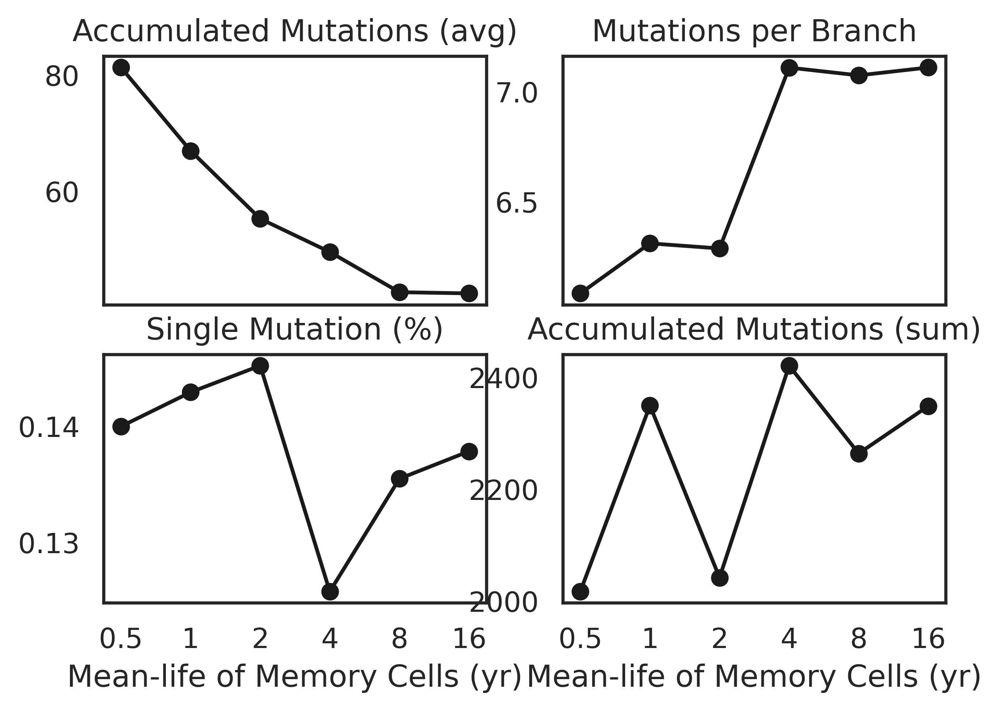

In [420]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["hl","hl1","hl2","hl4", "hl8", "hl16"]
    conditionLabels = ["0.5","1","2","4","8","16"]
    plot_line_graph(meanhw, ["truth"], condition, plot=axes[0, 0], showlegend=False, title="Accumulated Mutations (avg)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(ablw, ["truth"], condition, plot=axes[0, 1], showlegend=False, title="Mutations per Branch", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(sb, ["truth"], condition, plot=axes[1, 0], showlegend=False, title="Single Mutation (%)", colors=["k"], conditionLabels=conditionLabels)
    plot_line_graph(blw, ["truth"], condition, plot=axes[1, 1], showlegend=False, title="Accumulated Mutations (sum)", colors=["k"], conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Mean-life of Memory Cells (yr)")
    axes[1, 1].set_xlabel("Mean-life of Memory Cells (yr)")
    plt.savefig("property_true_life.pdf")

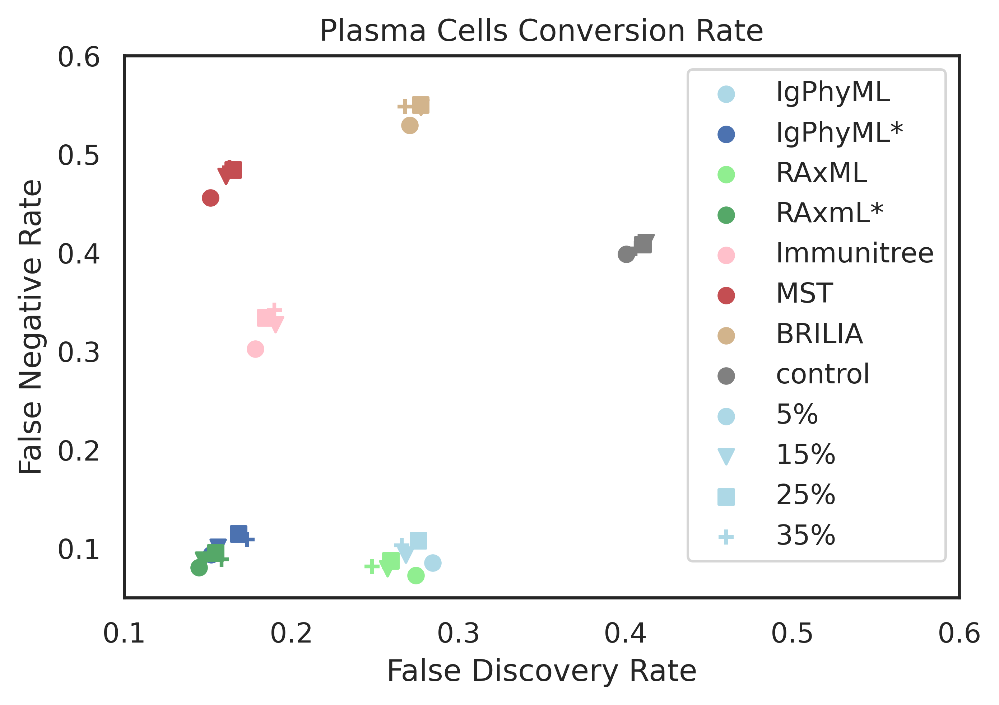

In [458]:
with sns.axes_style("white"):
    plt.xlim(0.1, 0.6)
    plt.ylim(0.05, 0.6)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["pl05","pl15","pl25","pl35"], True,
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["5%","15%","25%","35%"],
                          title='Plasma Cells Conversion Rate')
    plt.savefig("cluster_recovery_plasmacc.pdf")

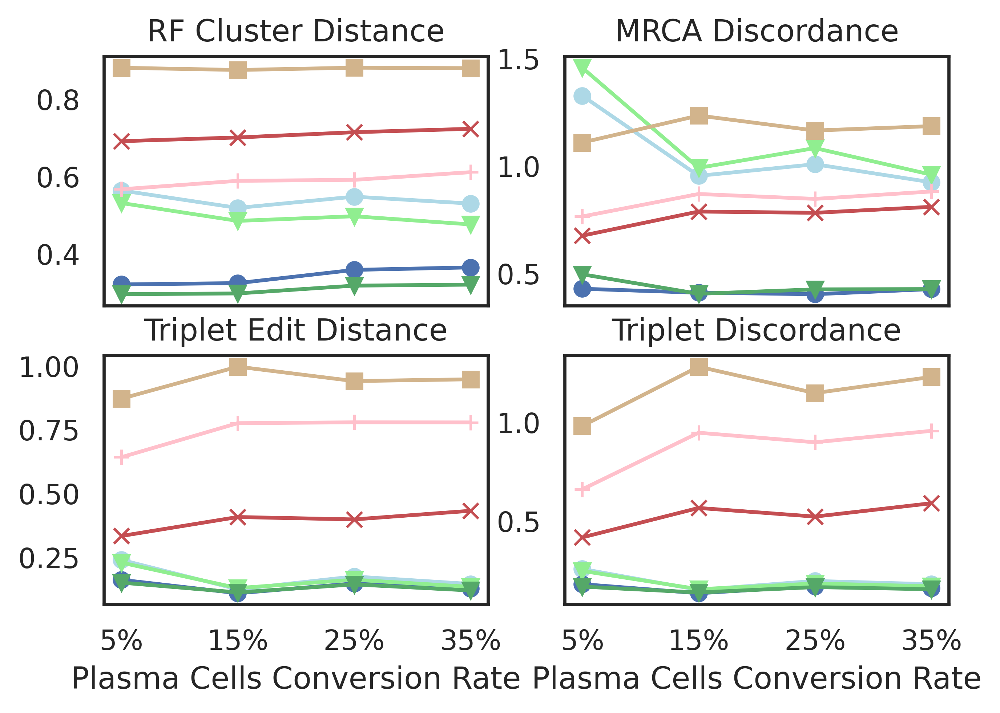

In [459]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["pl05","pl15","pl25","pl35"]
    conditionLabels = ["5%","15%","25%","35%"]
    plot_line_graph(rft, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="RF Cluster Distance", conditionLabels=conditionLabels)
    plot_line_graph(amrca, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="MRCA Discordance", conditionLabels=conditionLabels)
    plot_line_graph(dist, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Triplet Edit Distance", conditionLabels=conditionLabels)
    plot_line_graph(tripd, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Triplet Discordance", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Plasma Cells Conversion Rate")
    axes[1, 1].set_xlabel("Plasma Cells Conversion Rate")
    plt.savefig("evaluation_plasmacc.pdf")

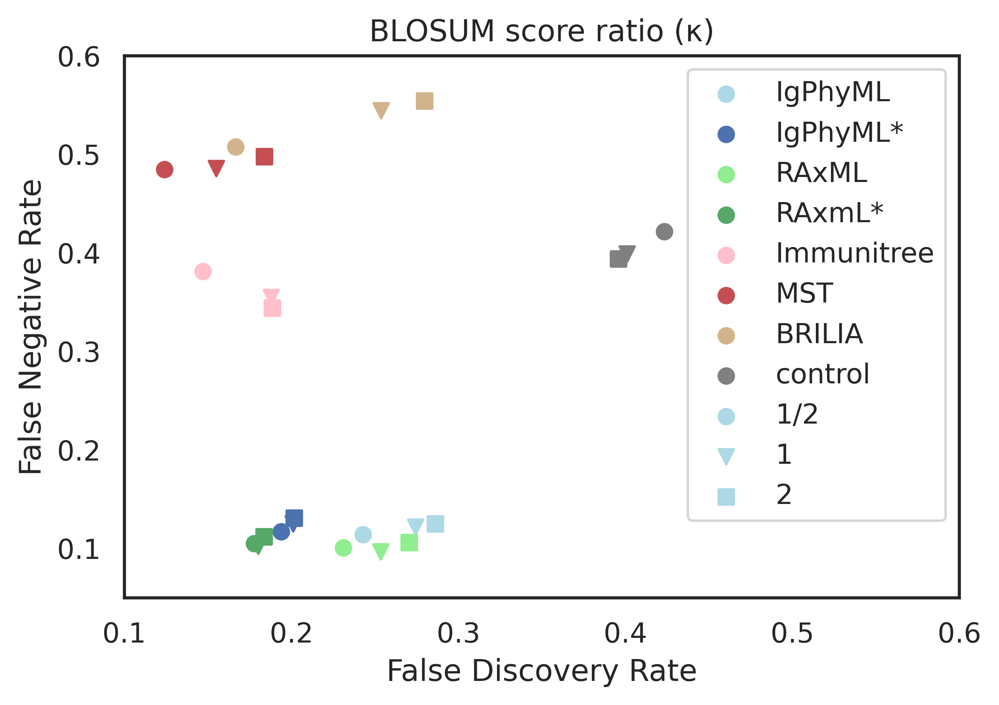

In [495]:
with sns.axes_style("white"):
    plt.xlim(0.1, 0.6)
    plt.ylim(0.05, 0.6)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["td","td1","td2"], True,
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["1/2","1","2"],
                          title=u'BLOSUM score ratio (κ)')
    plt.savefig("cluster_recovery_distance.pdf")

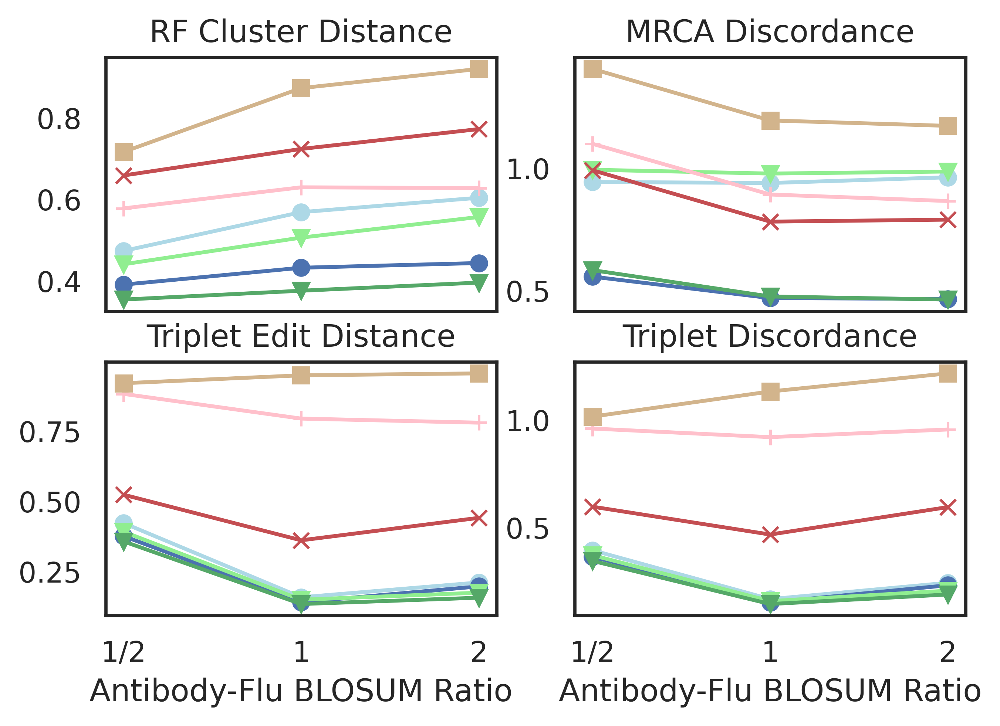

In [456]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["td","td1","td2"]
    conditionLabels = ["1/2","1","2"]
    plot_line_graph(rft, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="RF Cluster Distance", conditionLabels=conditionLabels)
    plot_line_graph(amrca, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="MRCA Discordance", conditionLabels=conditionLabels)
    plot_line_graph(dist, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Triplet Edit Distance", conditionLabels=conditionLabels)
    plot_line_graph(tripd, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Triplet Discordance", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Antibody-Flu BLOSUM Ratio")
    axes[1, 1].set_xlabel("Antibody-Flu BLOSUM Ratio")
    plt.savefig("evaluation_distance.pdf")

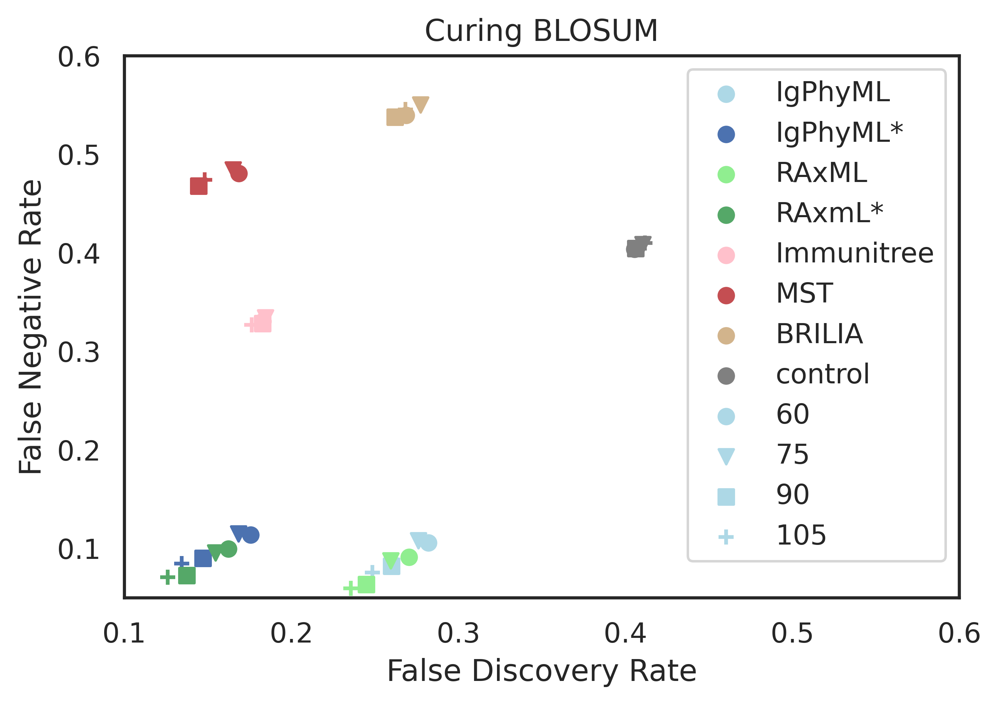

In [444]:
with sns.axes_style("white"):
    plt.xlim(0.1, 0.6)
    plt.ylim(0.05, 0.6)
    plot_precision_recall(["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia", "permut"], ["th4","th5","th6","th7"], True,
                          reconstructionLabels=["IgPhyML", "IgPhyML*", "RAxML", "RAxmL*", "Immunitree", "MST", "BRILIA", "control"],
                          conditionLabels=["60","75","90","105"],
                          title='Curing BLOSUM')
    plt.savefig("cluster_recovery_threshold.pdf")

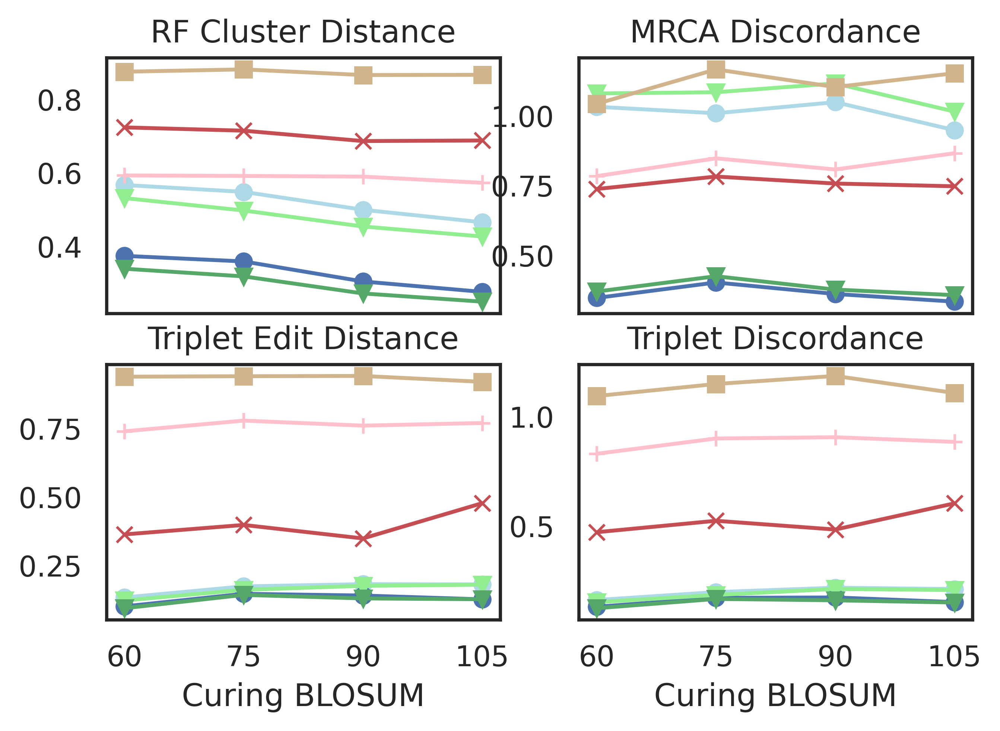

In [426]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 2, sharex=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    condition = ["th4","th5","th6","th7"]
    conditionLabels = ["60","75","90","105"]
    plot_line_graph(rft, reconstructionMethods, condition, plot=axes[0, 0], showlegend=False, title="RF Cluster Distance", conditionLabels=conditionLabels)
    plot_line_graph(amrca, reconstructionMethods, condition, plot=axes[0, 1], showlegend=False, title="MRCA Discordance", conditionLabels=conditionLabels)
    plot_line_graph(dist, reconstructionMethods, condition, plot=axes[1, 0], showlegend=False, title="Triplet Edit Distance", conditionLabels=conditionLabels)
    plot_line_graph(tripd, reconstructionMethods, condition, plot=axes[1, 1], showlegend=False, title="Triplet Discordance", conditionLabels=conditionLabels)
    axes[1, 0].set_xlabel("Curing BLOSUM")
    axes[1, 1].set_xlabel("Curing BLOSUM")
    plt.savefig("evaluation_threshold.pdf")

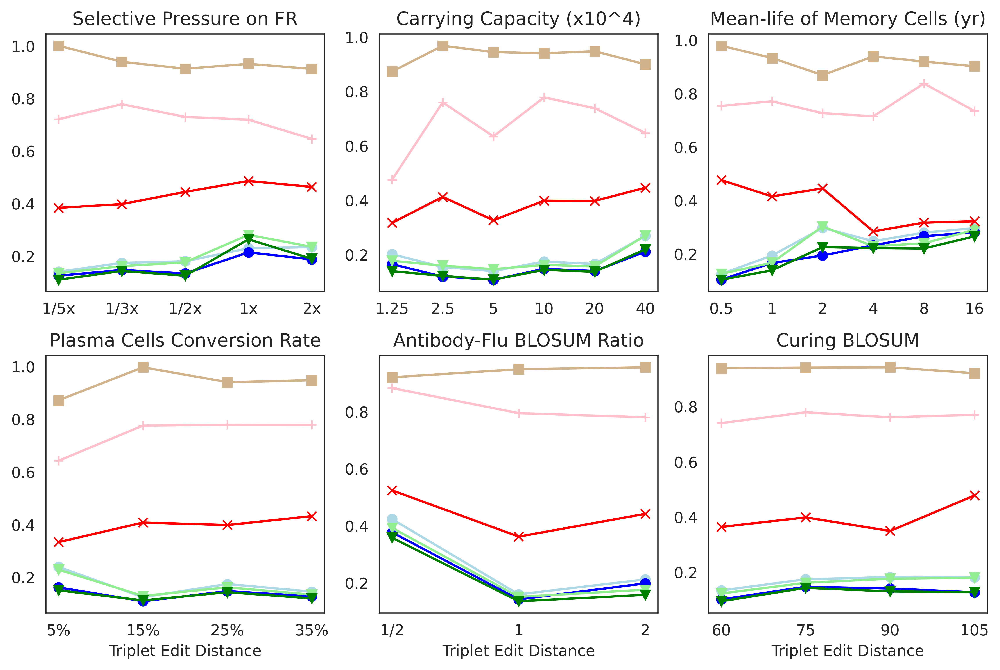

In [10]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 3, constrained_layout=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    plot_line_graph(dist, reconstructionMethods, ["fw5","fw3","fw2","fw1", "fw"], plot=axes[0, 0], showlegend=False, title="Selective Pressure on FR", conditionLabels=["1/5x","1/3x","1/2x","1x","2x"])
    plot_line_graph(dist, reconstructionMethods, ["gc125","gc250","gc500","gc1000", "gc2000", "gc4000"], plot=axes[0, 1], showlegend=False, title="Carrying Capacity (x10^4)", conditionLabels=["1.25","2.5","5","10","20","40"])
    plot_line_graph(dist, reconstructionMethods, ["hl","hl1","hl2","hl4", "hl8", "hl16"], plot=axes[0, 2], showlegend=False, title="Mean-life of Memory Cells (yr)", conditionLabels=["0.5","1","2","4","8","16"])
    plot_line_graph(dist, reconstructionMethods, ["pl05","pl15","pl25","pl35"], plot=axes[1, 0], showlegend=False, title="Plasma Cells Conversion Rate", conditionLabels=["5%","15%","25%","35%"])
    plot_line_graph(dist, reconstructionMethods, ["td","td1","td2"], plot=axes[1, 1], showlegend=False, title="Antibody-Flu BLOSUM Ratio", conditionLabels=["1/2","1","2"])
    plot_line_graph(dist, reconstructionMethods, ["th4","th5","th6","th7"], plot=axes[1, 2], showlegend=False, title="Curing BLOSUM", conditionLabels=["60","75","90","105"])
    axes[1, 0].set_xlabel("Triplet Edit Distance")
    axes[1, 1].set_xlabel("Triplet Edit Distance")
    axes[1, 2].set_xlabel("Triplet Edit Distance")
    fig.set_size_inches(9, 6)
    plt.savefig("other_triplet_edit_distance.pdf")

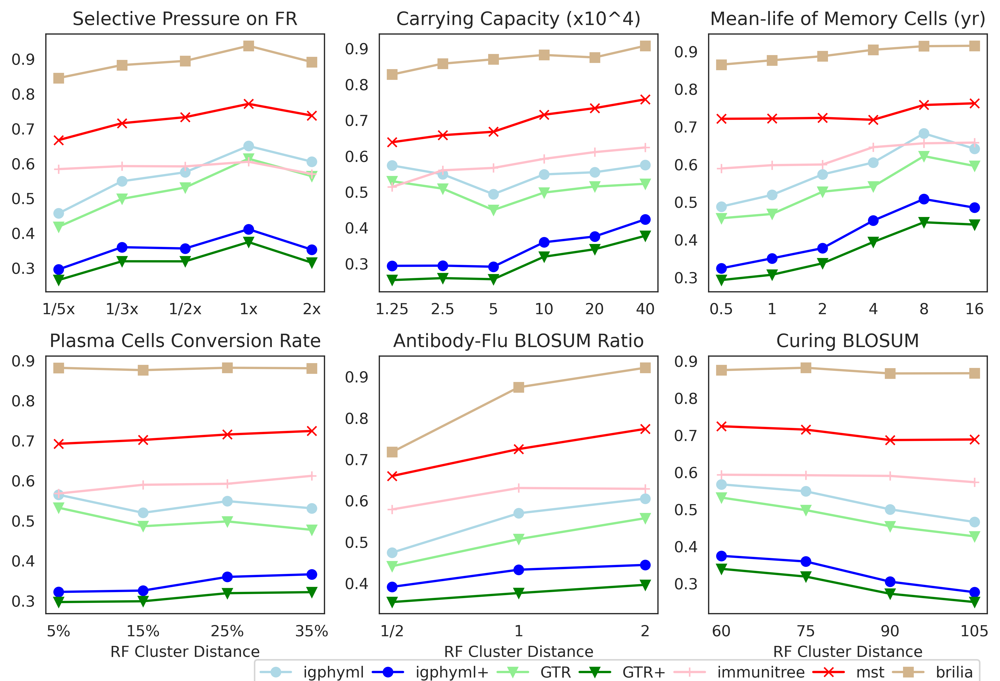

In [43]:
with sns.axes_style("white"):
    fig, axes = plt.subplots(2, 3, constrained_layout=True)
    reconstructionMethods = ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]
    plot_line_graph(rft, reconstructionMethods, ["fw5","fw3","fw2","fw1", "fw"], plot=axes[0, 0], showlegend=False, title="Selective Pressure on FR", conditionLabels=["1/5x","1/3x","1/2x","1x","2x"])
    plot_line_graph(rft, reconstructionMethods, ["gc125","gc250","gc500","gc1000", "gc2000", "gc4000"], plot=axes[0, 1], showlegend=False, title="Carrying Capacity (x10^4)", conditionLabels=["1.25","2.5","5","10","20","40"])
    plot_line_graph(rft, reconstructionMethods, ["hl","hl1","hl2","hl4", "hl8", "hl16"], plot=axes[0, 2], showlegend=False, title="Mean-life of Memory Cells (yr)", conditionLabels=["0.5","1","2","4","8","16"])
    plot_line_graph(rft, reconstructionMethods, ["pl05","pl15","pl25","pl35"], plot=axes[1, 0], showlegend=False, title="Plasma Cells Conversion Rate", conditionLabels=["5%","15%","25%","35%"])
    plot_line_graph(rft, reconstructionMethods, ["td","td1","td2"], plot=axes[1, 1], showlegend=False, title="Antibody-Flu BLOSUM Ratio", conditionLabels=["1/2","1","2"])
    plot_line_graph(rft, reconstructionMethods, ["th4","th5","th6","th7"], plot=axes[1, 2], showlegend=False, title="Curing BLOSUM", conditionLabels=["60","75","90","105"])
    axes[1, 0].set_xlabel("RF Cluster Distance")
    axes[1, 1].set_xlabel("RF Cluster Distance")
    axes[1, 2].set_xlabel("RF Cluster Distance")
    handles, labels = axes[1, 2].get_legend_handles_labels()
    fig.legend(handles, labels, bbox_to_anchor=(0.25, -0.02, 0.75, 0.015), loc='lower left',
           ncol=7, mode="expand")
    fig.set_size_inches(9, 6)
    plt.savefig("other_RF_distance.pdf")

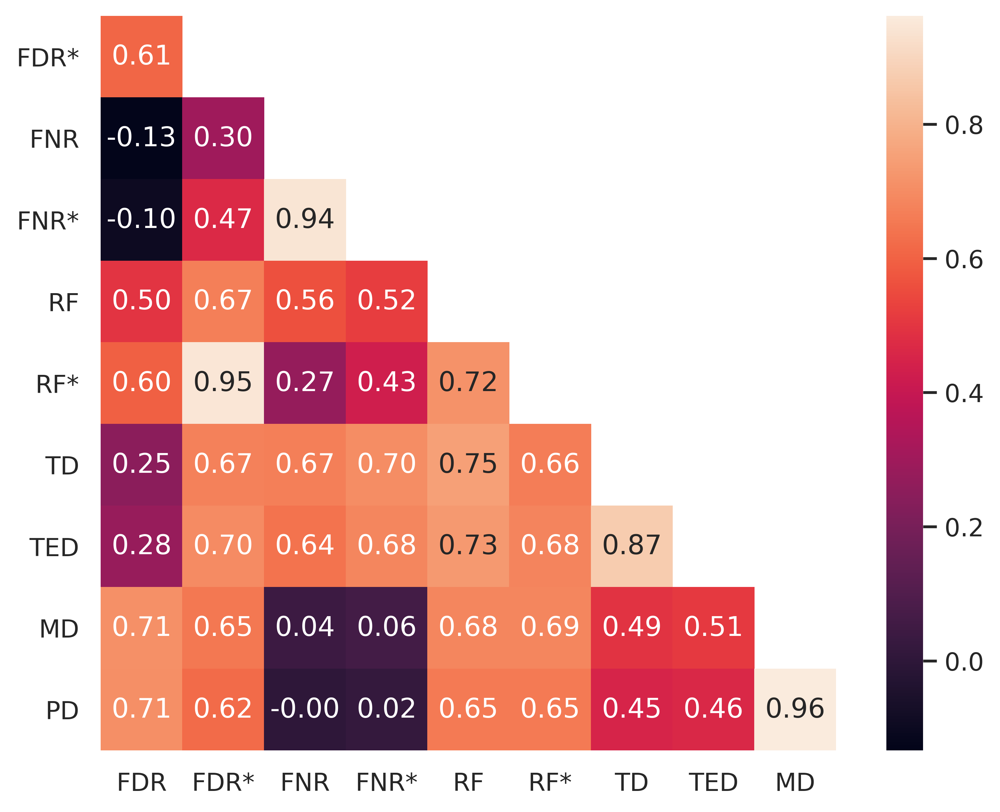

In [119]:
emList = [ctp, cp, ctr, cr, rft, rf, tripd, dist, amrca, mrca]
emNames = ["FDR", "FDR*", "FNR", "FNR*", "RF", "RF*", "TD", "TED", "MD", "PD"]
corstat = dict([(em, []) for em in emList])
#norm_raw_data = dict([(e, dict([(r, {}) for r in reconstructionMethods])) for e in evaluationMethods])
for em in emList:
    for condition in norm_raw_data[em]["brilia"]:
        for runId in norm_raw_data[em]["brilia"][condition]:
            if len([rm for rm in ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"] if runId not in norm_raw_data[em][rm][condition]]) > 0:
                continue
            data = np.array([norm_raw_data[em][rm][condition][runId] for rm in ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]])
            data = data.argsort().argsort()
            for v in data:
                corstat[em].append(v)
corrstat = np.array([corstat[em] for em in emList])
corr = np.corrcoef(corrstat)
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(8, 6))
    ax = sns.heatmap(corr[1:,:-1], annot=corr[1:,:-1], mask=mask[1:,:-1], xticklabels=emNames[:-1], yticklabels=emNames[1:], fmt=".2f", square=True)
    ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)
    plt.savefig("eval_corr.pdf")

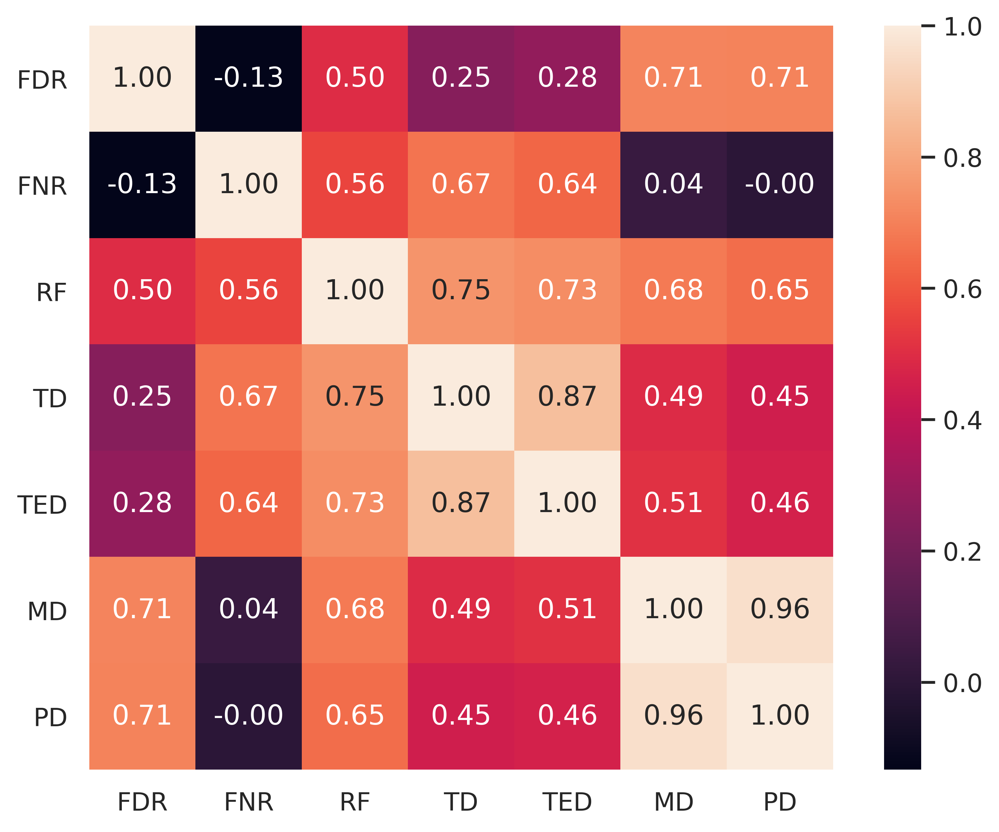

In [123]:
emList = [ctp, ctr, rft, tripd, dist, amrca, mrca]
emNames = ["FDR", "FNR", "RF", "TD", "TED", "MD", "PD"]
corstat = dict([(em, []) for em in emList])
#norm_raw_data = dict([(e, dict([(r, {}) for r in reconstructionMethods])) for e in evaluationMethods])
for em in emList:
    for condition in norm_raw_data[em]["brilia"]:
        for runId in norm_raw_data[em]["brilia"][condition]:
            if len([rm for rm in ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"] if runId not in norm_raw_data[em][rm][condition]]) > 0:
                continue
            data = np.array([norm_raw_data[em][rm][condition][runId] for rm in ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]])
            data = data.argsort().argsort()
            for v in data:
                corstat[em].append(v)
corrstat = np.array([corstat[em] for em in emList])
corr = np.corrcoef(corrstat)
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(8, 6))
    ax = sns.heatmap(corr, annot=corr, xticklabels=emNames, yticklabels=emNames, fmt=".2f", square=True)
    ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)
    plt.savefig("eval_corr_no_star.pdf")

In [ ]:
emList = [ctp, cp, ctr, cr, rft, rf, tripd, dist, amrca, mrca]
emNames = ["FDR", "FDR*", "FNR", "FNR*", "RF", "RF*", "TD", "TED", "MD", "PD"]
corstat = dict([(em, []) for em in emList])
#norm_raw_data = dict([(e, dict([(r, {}) for r in reconstructionMethods])) for e in evaluationMethods])
for em in emList:
    for condition in norm_raw_data[em]["brilia"]:
        for runId in norm_raw_data[em]["brilia"][condition]:
            if len([rm for rm in ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"] if runId not in norm_raw_data[em][rm][condition]]) > 0:
                continue
            data = np.array([norm_raw_data[em][rm][condition][runId] for rm in ["igphyml", "igphyml+", "GTR", "GTR+", "immunitree", "mst", "brilia"]])
            data = data.argsort().argsort()
            for v in data:
                corstat[em].append(v)
corrstat = np.array([corstat[em] for em in emList])
corr = np.corrcoef(corrstat)
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(8, 6))
    ax = sns.heatmap(corr[1:,:-1], annot=corr[1:,:-1], mask=mask[1:,:-1], xticklabels=emNames[:-1], yticklabels=emNames[1:], fmt=".2f", square=True)
    ax.set_yticklabels(ax.get_yticklabels(), rotation = 0)
    plt.savefig("eval_corr.pdf")